In [4]:
import os
import sys
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.impute import SimpleImputer


sys.path.append(os.path.abspath('..'))

from dataframe_generator import *
from image_patching import *

In [5]:
df, split_variables = create_dataframe()
df

                             image_path category
0        ../data/CBIR_15-Scene/00/1.jpg  Bedroom
1        ../data/CBIR_15-Scene/00/2.jpg  Bedroom
2        ../data/CBIR_15-Scene/00/3.jpg  Bedroom
3        ../data/CBIR_15-Scene/00/4.jpg  Bedroom
4        ../data/CBIR_15-Scene/00/5.jpg  Bedroom
...                                 ...      ...
4480  ../data/CBIR_15-Scene/14/4481.jpg    Store
4481  ../data/CBIR_15-Scene/14/4482.jpg    Store
4482  ../data/CBIR_15-Scene/14/4483.jpg    Store
4483  ../data/CBIR_15-Scene/14/4484.jpg    Store
4484  ../data/CBIR_15-Scene/14/4485.jpg    Store

[4485 rows x 2 columns]


,image_path,category
0,../data/CBIR_15-Scene/00/1.jpg,Bedroom
1,../data/CBIR_15-Scene/00/2.jpg,Bedroom
2,../data/CBIR_15-Scene/00/3.jpg,Bedroom
3,../data/CBIR_15-Scene/00/4.jpg,Bedroom
4,../data/CBIR_15-Scene/00/5.jpg,Bedroom
...,...,...
4480,../data/CBIR_15-Scene/14/4481.jpg,Store
4481,../data/CBIR_15-Scene/14/4482.jpg,Store
4482,../data/CBIR_15-Scene/14/4483.jpg,Store
4483,../data/CBIR_15-Scene/14/4484.jpg,Store


# Now we are going to work with 2 similar environments

In [6]:
X = df['image_path']
y = df['category']
(X_train, X_test, y_train, y_test) = train_test_split(X, y, test_size=0.2, random_state=10)


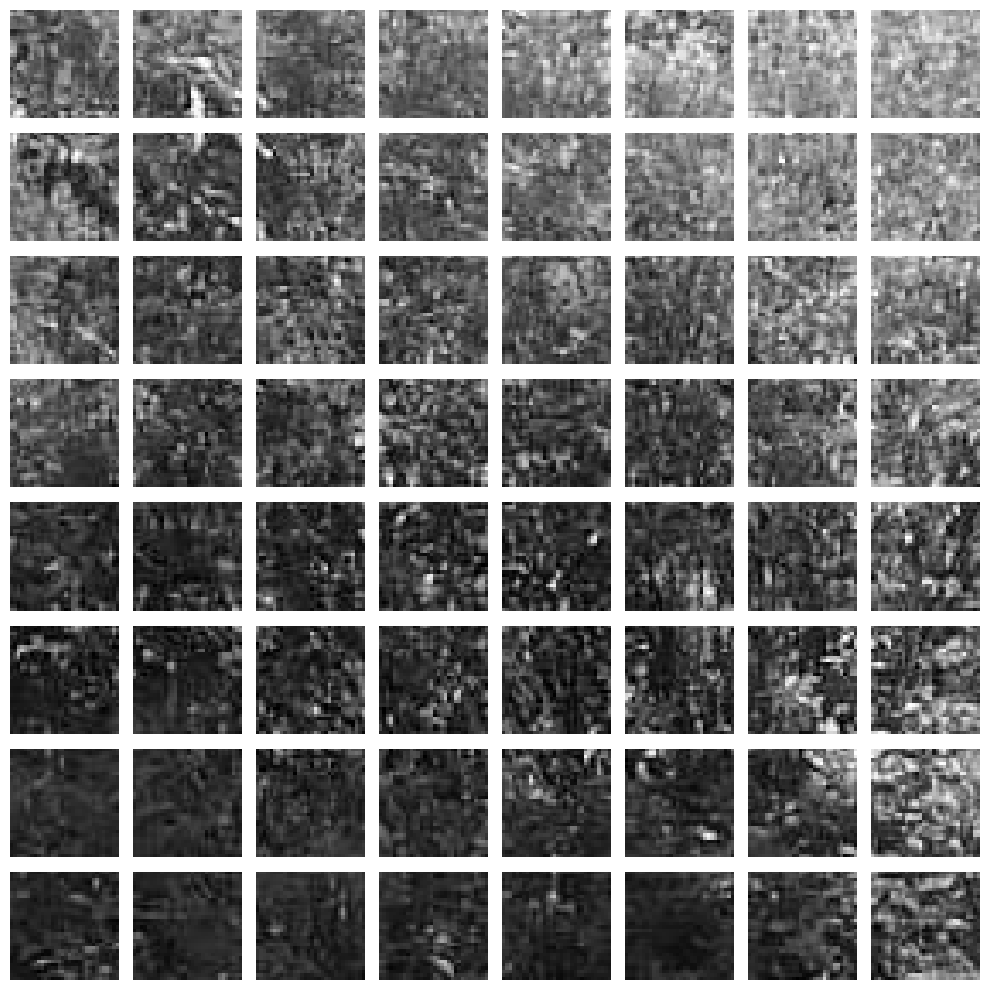

In [7]:
# Função para criar a grid de patches
def plot_patches_grid(patches, patch_size, grid_shape):
    fig, axes = plt.subplots(grid_shape[0], grid_shape[1], figsize=(10, 10))
    patch_idx = 0
    for i in range(grid_shape[0]):
        for j in range(grid_shape[1]):
            if patch_idx < len(patches):
                axes[i, j].imshow(cv2.cvtColor(patches[patch_idx], cv2.COLOR_BGR2RGB))
                axes[i, j].axis('off')
                patch_idx += 1
            else:
                axes[i, j].axis('off')
    plt.tight_layout()
    plt.show()

patch_size = (32,32)

# Carregar a primeira imagem de treino e criar os patches
first_image_path = X_train.iloc[0]
image = cv2.imread(first_image_path)
resized_image = resize_image(image, standard_size)
patches, positions = create_patches(resized_image, patch_size)

# Determinar o número de patches na grid
grid_rows = resized_image.shape[0] // patch_size[0]
grid_cols = resized_image.shape[1] // patch_size[1]

# Plotar a grid de patches
plot_patches_grid(patches, patch_size, (grid_rows, grid_cols))


In [8]:
create_images_set(X_train, X_test, y_train, y_test, patch_size, output_dir_train='patches_train', output_dir_test='patches_test')

In [9]:
patches_by_category = load_patches_by_category('patches_train', y, patch_size)


In [10]:
# Função para imputar NaNs
def impute_nans(patches):
    imputer = SimpleImputer(strategy='mean')
    patches = imputer.fit_transform(patches)
    return patches

def normalize_patches(patches):
    patches = patches.astype(np.float32)
    mean = np.mean(patches, axis=0)
    std = np.std(patches, axis=0)
    normalized_patches = (patches - mean) / (std)
    return normalized_patches


# Normalizar patches para cada categoria
normalized_patches_by_category = {}
for category, patches in patches_by_category.items():
    normalized_patches = normalize_patches(patches)
    normalized_patches_by_category[category] = normalized_patches  
    

In [11]:
from sklearn.decomposition import PCA
# Aplicar PCA para cada categoria e visualizar componentes
def apply_pca_and_visualize(patches_by_category, n_components=1024):
    pca_by_category = {}
    num_components_95_dict = {}
    for category, patches in patches_by_category.items():
        print(patches)
        if patches.size == 0:
            continue  # Pular se não houver patches para esta categoria
        
        #patches = impute_nans(patches)

        # Normalizar patches
        #patches = normalize_patches(patches)
        
        pca = PCA(n_components=n_components)
        pca.fit(patches)
        components = pca.components_
        variance = pca.explained_variance_
        
        # Plotar os 320 primeiros componentes principais
        fig, axes = plt.subplots(16, 20, figsize=(20, 16))
        for i, ax in enumerate(axes.flatten()):
            ax.imshow(components[i].reshape(32, 32), cmap='gray')
            ax.axis('off')
        plt.suptitle(f'{n_components} Principal Components  - Category: {category}')
        plt.show()
        
        # Plotar a log-variância dos componentes principais
        plt.figure(figsize=(10, 6))
        plt.plot(np.log(variance))
        plt.title(f'Log-Variance of Principal Components - Category: {category}')
        plt.xlabel('Index of the Principal Component')
        plt.ylabel('Log-Variance')
        plt.grid(True)
        plt.show()

        cumulative_variance = np.cumsum(pca.explained_variance_ratio_)
        num_components_95 = np.where(cumulative_variance >= 0.95)[0][0] + 1

        #We take the PCA with the minimum significant components
        pca = PCA(n_components=num_components_95)
        pca.fit(patches)

        pca_by_category[category] = pca
        num_components_95_dict[category] = num_components_95

        print("Category: " + category)
        print("Number of components that explain 95% of variance: " + str(num_components_95))

    
    min_num_components = min(num_components_95_dict.values())
    return pca_by_category,num_components_95_dict, min_num_components

[[-0.03874368 -0.1828905  -0.41365373 ...  0.5735626   0.55365795
   0.53580654]
 [ 1.8834835   1.8150499   1.8872042  ...  0.25263682  0.20288934
   0.12719736]
 [-1.3514842  -1.4414356  -1.5956013  ... -1.4436853  -1.4746997
  -1.476972  ]
 ...
 [ 0.53948724  0.5565048   0.54766357 ...  0.05396847  0.03513043
   0.02126164]
 [ 1.8209721   1.5790727   0.6264601  ... -0.6337297  -0.59015274
  -0.44788224]
 [ 0.88330024  0.06881852 -0.14574564 ... -0.35865045 -0.39189222
  -0.41761488]]


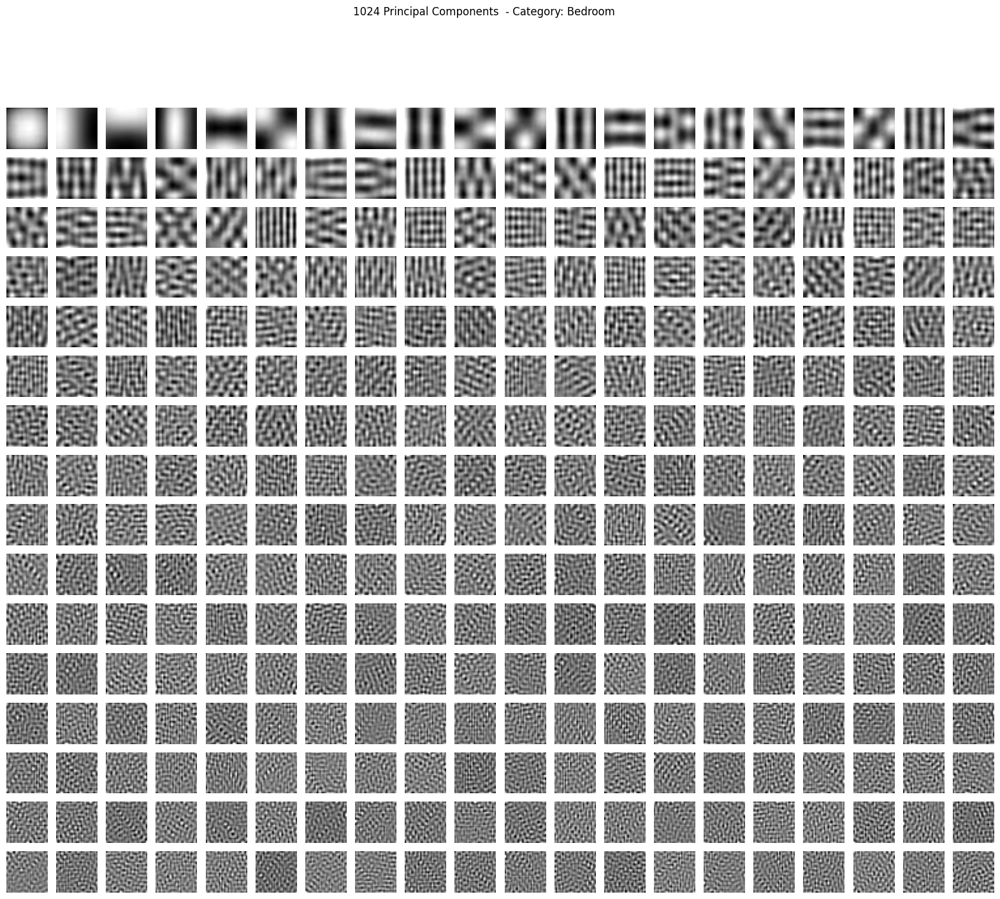

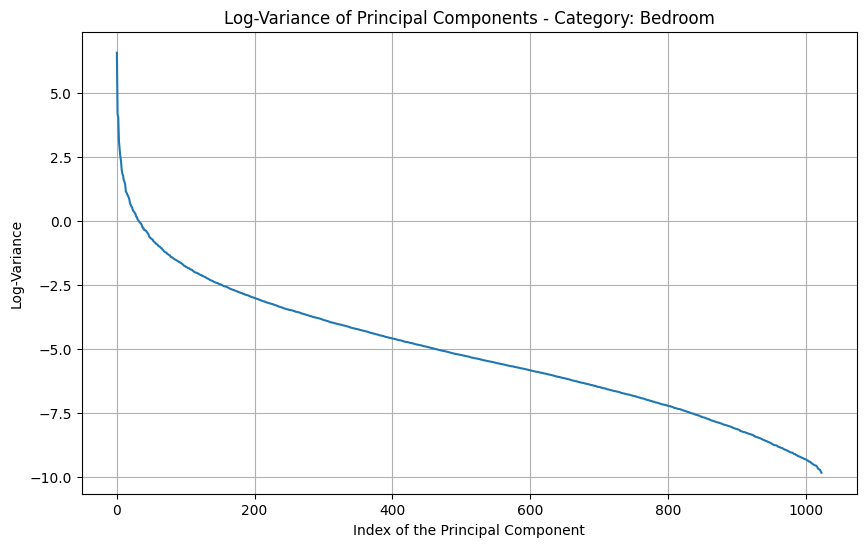

Category: Bedroom
Number of components that explain 95% of variance: 26
[[-0.4764806  -0.11061098 -0.1651358  ... -0.74793035 -0.71766126
  -0.68868613]
 [ 1.686103    1.6888151   1.6856025  ...  1.7605028   1.7604665
   1.7651132 ]
 [-0.7316923  -0.6611817  -0.63452595 ... -1.2631761  -1.2999535
  -1.3123037 ]
 ...
 [-1.2152513  -1.1714667  -1.0636827  ... -1.2089397  -1.1374533
  -0.8106983 ]
 [ 0.32945117  0.4131026   0.5590662  ... -0.53098476 -0.3249525
  -0.56667405]
 [ 0.15483262  0.06396021  0.00920911 ...  1.3130525   1.3542159
   1.4261907 ]]


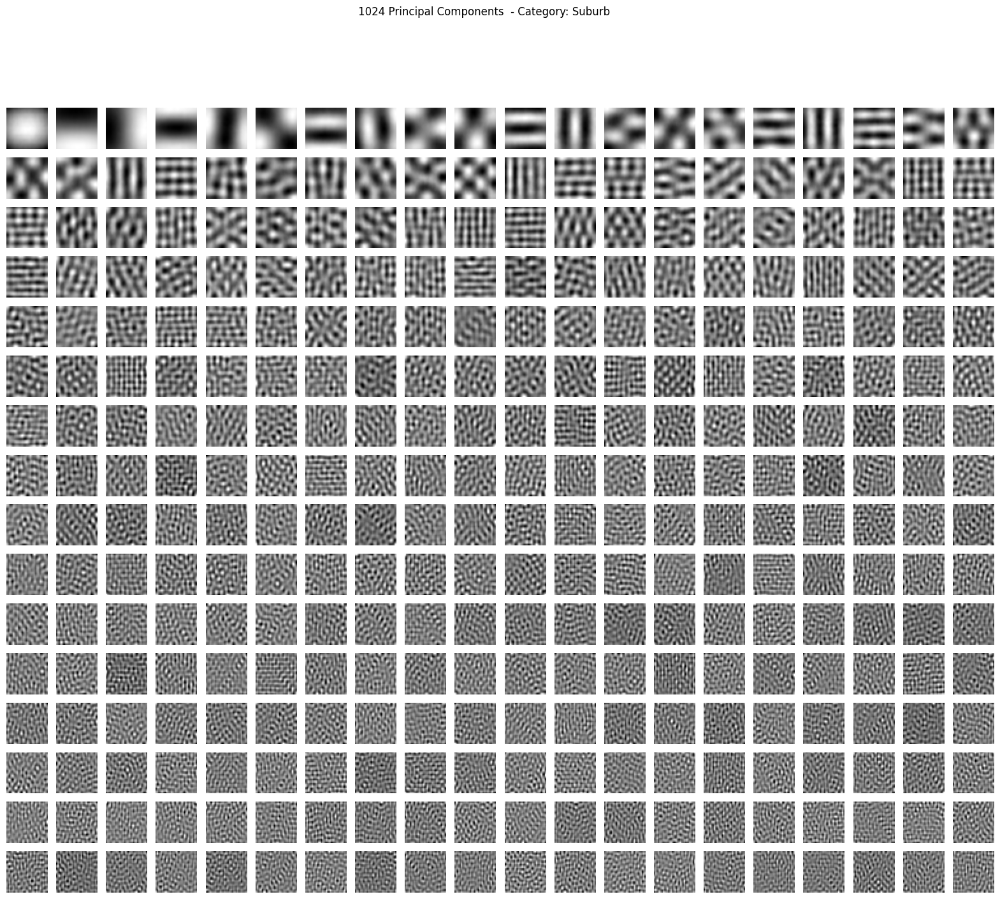

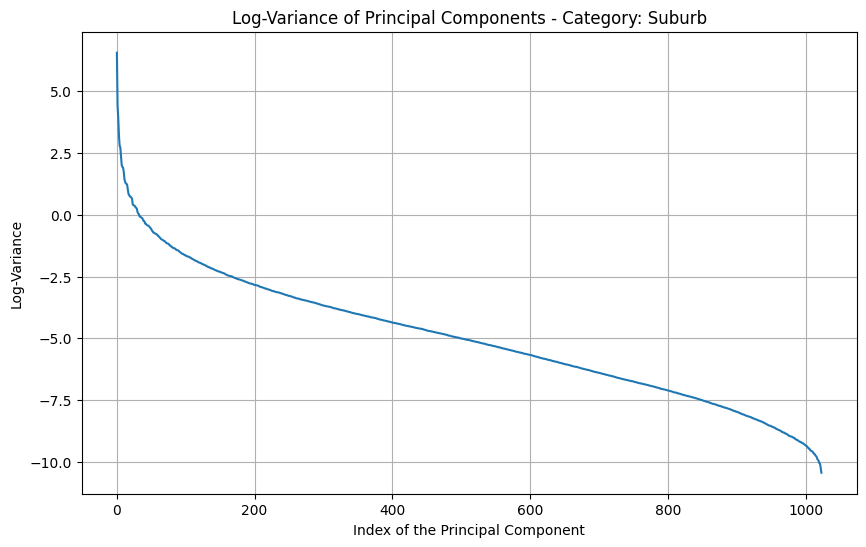

Category: Suburb
Number of components that explain 95% of variance: 30
[[ 1.6608531   1.6596255   1.6616386  ... -1.1061233  -0.08705791
   1.8202777 ]
 [ 1.6335943   1.6459795   1.6616386  ... -1.2333353   0.47787783
  -0.21197402]
 [-0.45170814 -0.3463298  -0.36287764 ... -0.7244875  -0.6661171
  -0.6071341 ]
 ...
 [-0.19274901 -0.18257836 -0.15769017 ... -1.2050658  -1.2169294
  -1.2845514 ]
 [-1.0922912  -1.192379   -0.96476084 ... -1.1626619  -1.2451762
  -1.3410028 ]
 [-0.36993158 -0.41455957 -0.54070675 ... -0.9647767  -1.3016697
  -1.0446328 ]]


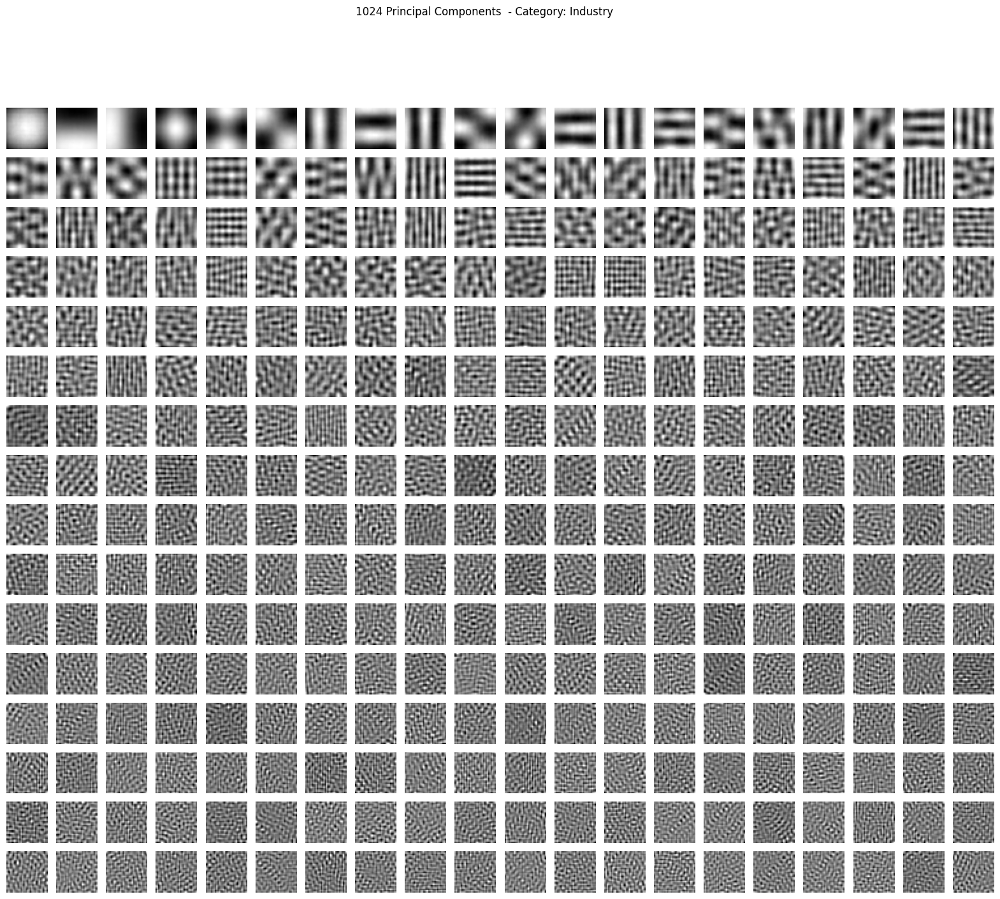

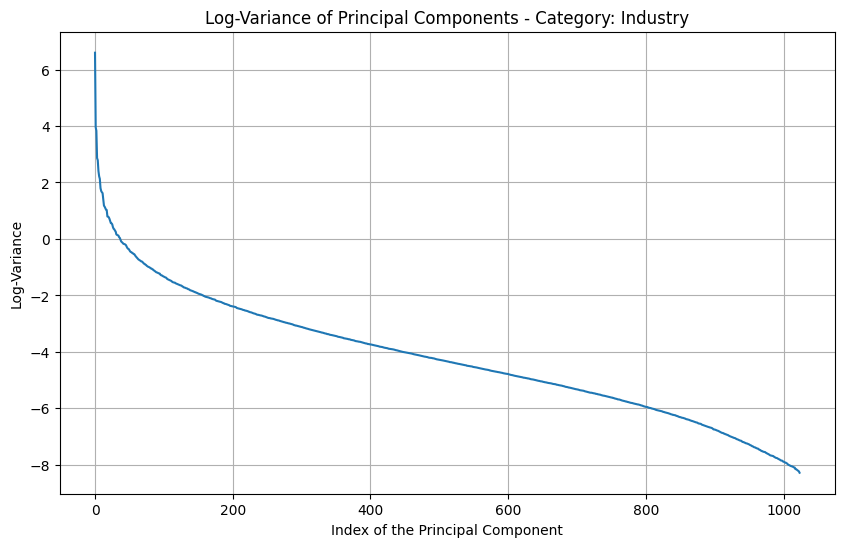

Category: Industry
Number of components that explain 95% of variance: 49
[[-0.48719484 -0.55723643 -0.5249806  ... -0.7284756  -0.7107219
  -0.65977687]
 [ 0.14904     0.14694704  0.12965466 ...  0.31420332  0.27952778
   0.42639154]
 [-0.20256345 -0.18837842 -0.20605572 ... -0.1062317  -0.10650176
  -0.09162723]
 ...
 [-0.7885692  -0.79196423 -0.84390545 ... -1.0984584  -1.1806709
  -1.1777956 ]
 [-0.10210533  0.14694704 -0.03820053 ... -1.2834498  -1.5834843
  -1.5955527 ]
 [-1.1234297  -1.144056   -1.1292592  ... -1.3843542  -1.4324293
  -1.4451602 ]]


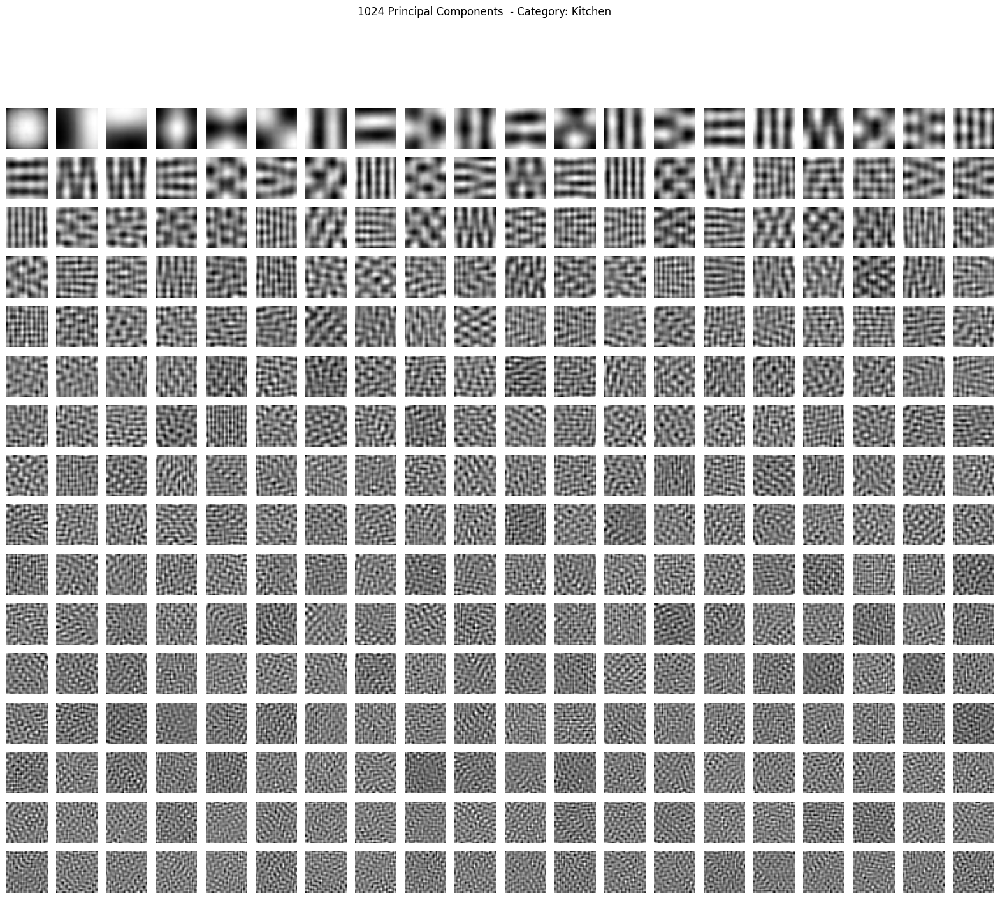

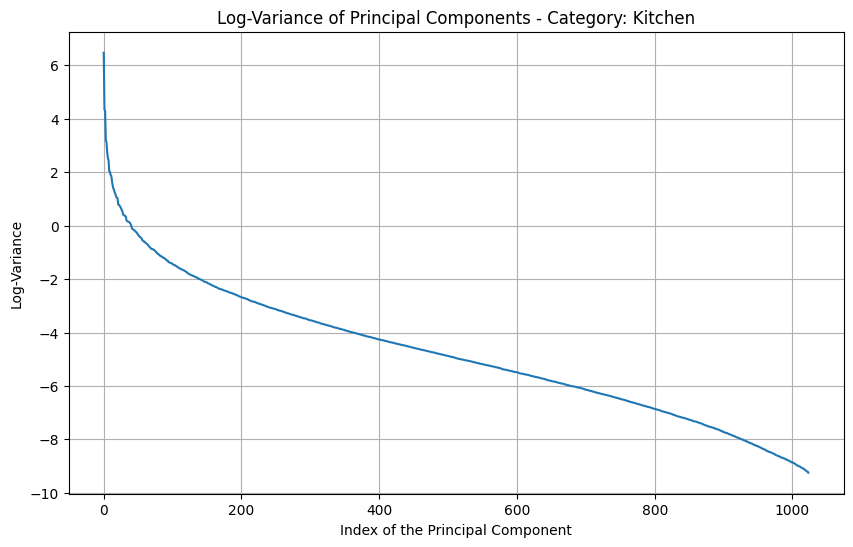

Category: Kitchen
Number of components that explain 95% of variance: 40
[[ 0.10773624  0.0028791  -0.04117822 ...  0.11607187  0.21850762
   1.4780835 ]
 [-0.40375116 -0.1331153  -0.47965088 ... -0.896664   -0.943221
  -0.8060205 ]
 [ 0.61922365  0.65263015  0.6240907  ... -0.35250744 -0.79234713
   1.4330025 ]
 ...
 [-0.43383867 -0.76775587 -0.78204584 ...  0.01026364 -0.00780314
   0.03549147]
 [-1.2010697  -1.2210705  -1.2205185  ...  2.02062     1.9837316
   1.9739745 ]
 [ 0.21304247  0.0028791  -0.14701645 ...  0.5846512   0.47499317
   0.59149045]]


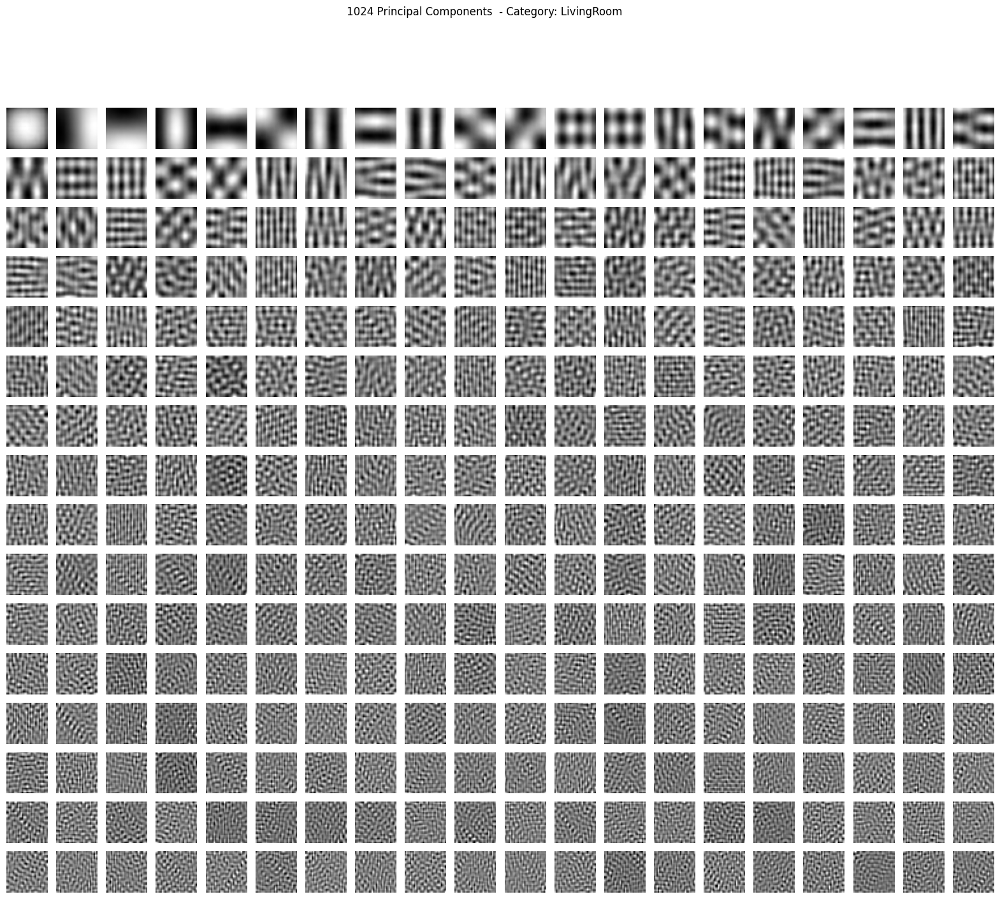

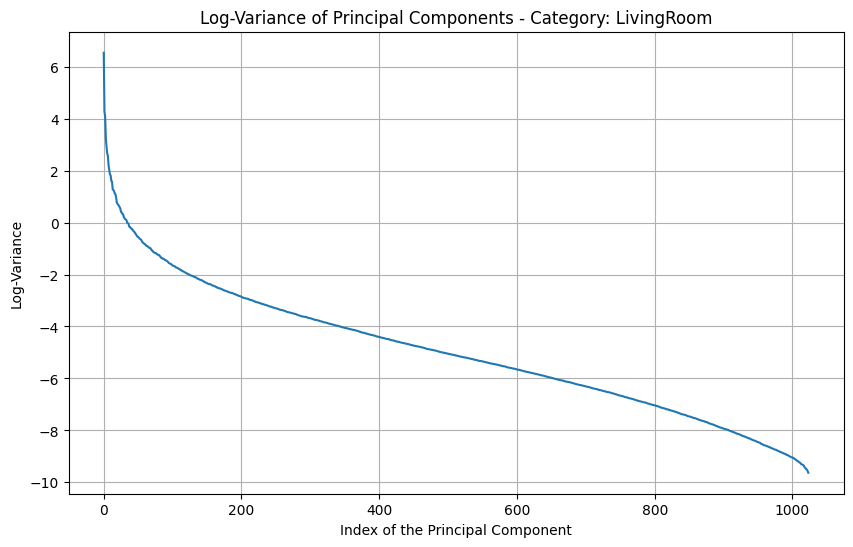

Category: LivingRoom
Number of components that explain 95% of variance: 31
[[-0.7390603  -0.7102101  -0.67762977 ... -1.5965182  -1.6106609
  -1.8047225 ]
 [-1.7877101  -1.491568   -1.3912222  ... -0.3305913  -0.3787242
  -0.2611656 ]
 [ 0.37724435  0.3768966   0.35877833 ...  0.2690583  -0.02912056
   0.40272987]
 ...
 [-1.8722786  -1.865261   -1.8499602  ...  2.251233    2.2516272
   2.2450397 ]
 [-1.8553649  -1.865261   -1.8669505  ...  1.6016128   1.5857153
   1.5811443 ]
 [-0.89128363 -1.1008891  -1.1703484  ... -1.2966933  -0.66173667
  -0.89186627]]


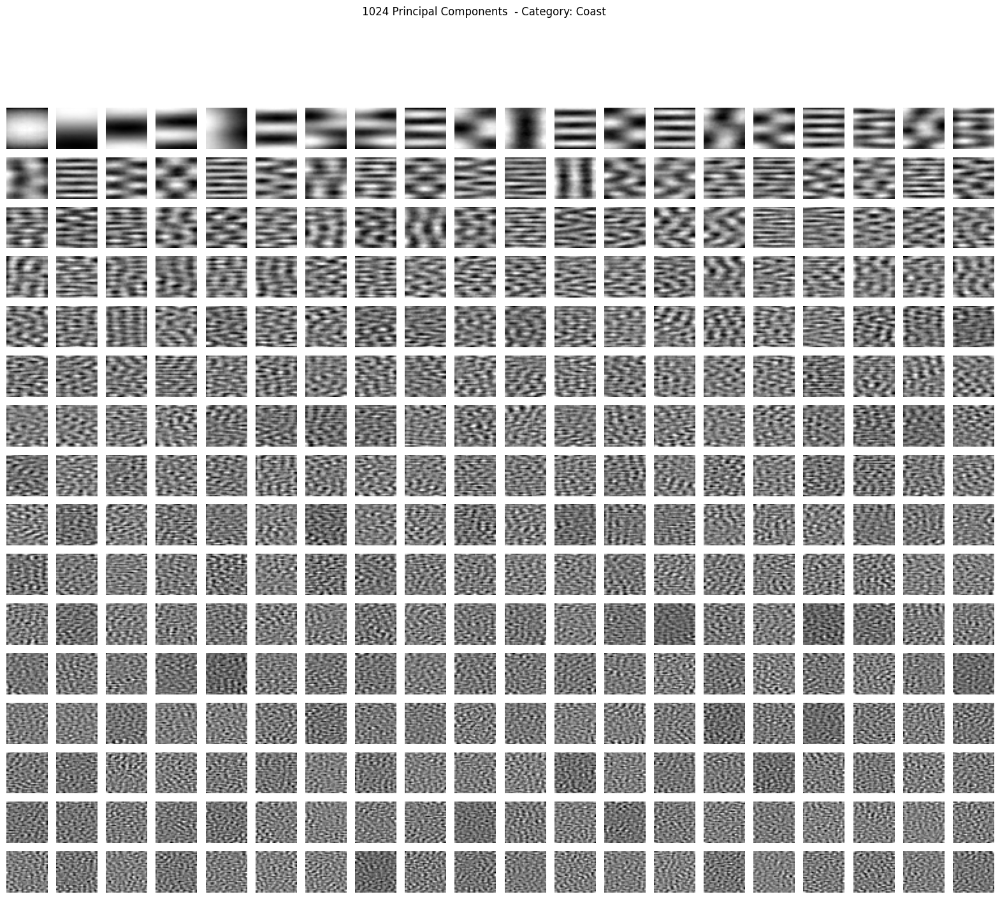

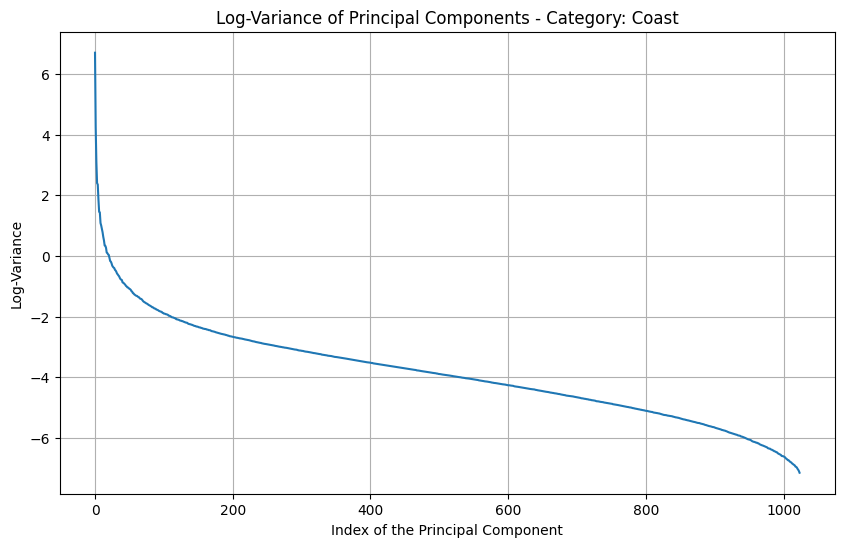

Category: Coast
Number of components that explain 95% of variance: 23
[[ 0.12444156 -0.3289945   0.5217199  ...  0.7764567   0.62862355
   0.997885  ]
 [-1.1284046  -1.1876855  -1.1150635  ...  1.739067    1.3246542
   1.1123992 ]
 [ 1.3447464   1.5504045   1.234774   ...  1.2245684   1.5898087
   1.7176887 ]
 ...
 [-1.2097583  -1.0742735  -1.0664462  ... -1.3313278  -1.4428962
  -1.4887097 ]
 [-1.3073827  -1.4631147  -1.5688252  ... -1.5802788  -1.4760405
  -1.3087587 ]
 [-0.90061444 -0.6854323  -0.20754007 ... -0.38531426 -0.6474326
  -1.243322  ]]


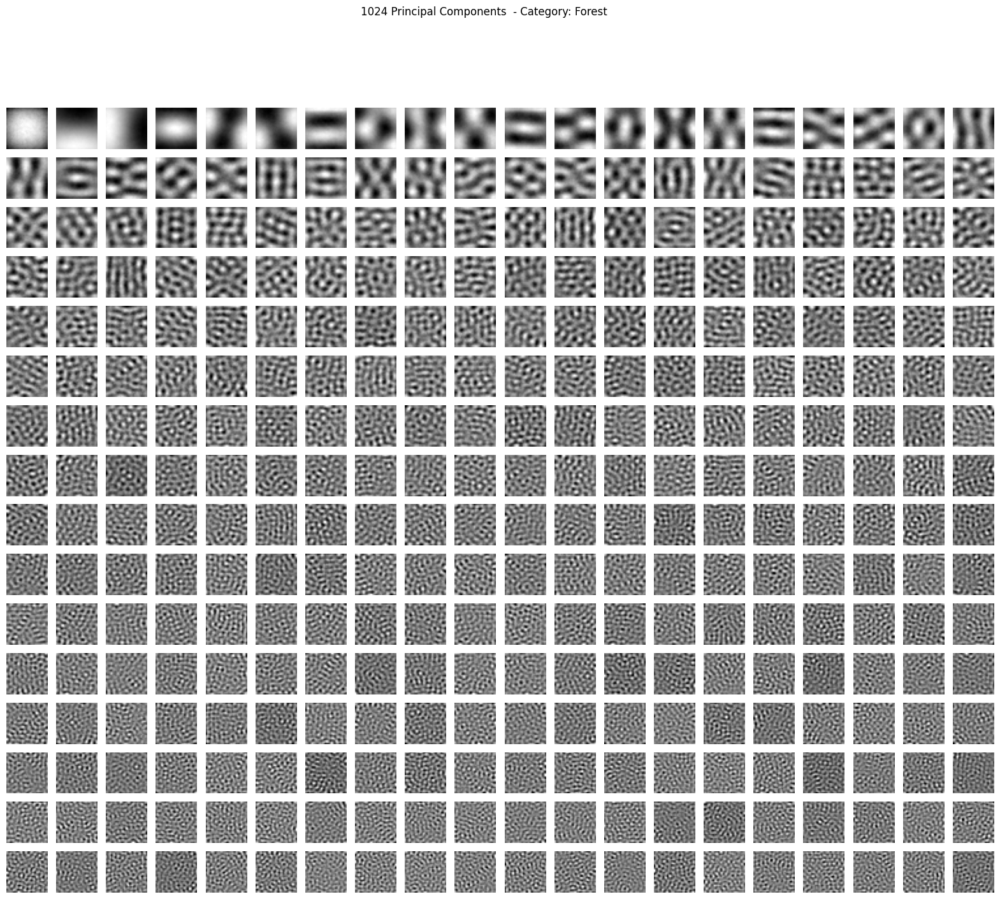

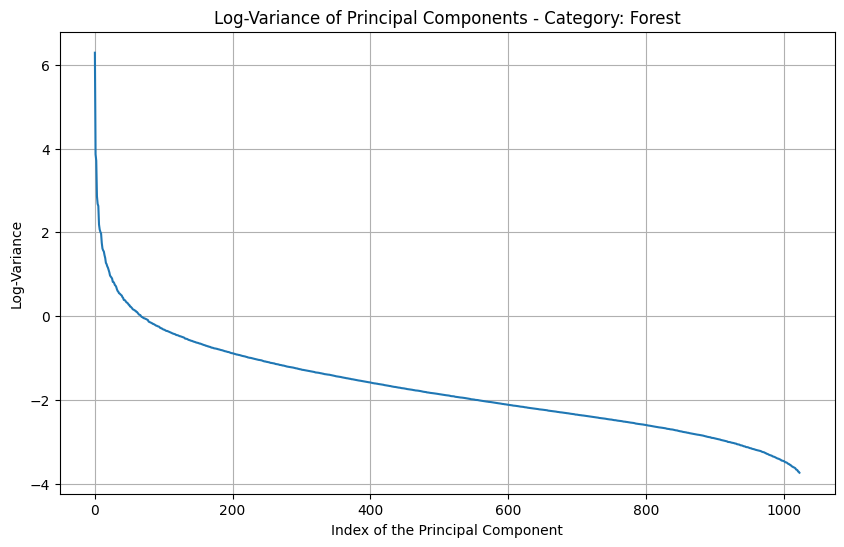

Category: Forest
Number of components that explain 95% of variance: 458
[[-0.7233399  -0.7396235  -0.7545113  ... -0.82489556 -0.8388769
  -0.826627  ]
 [-0.02162567  0.31410122  0.18939413 ...  0.52346015  0.46678352
   0.6428817 ]
 [-0.8156707  -0.7950827  -0.73600334 ... -0.89777964 -0.9476819
  -0.9899057 ]
 ...
 [ 0.957081    0.94263875  0.9482201  ...  1.5073954  -0.25858337
  -0.86291116]
 [-1.184994   -1.2757291  -1.3652736  ... -1.2622001  -1.274097
  -1.2983211 ]
 [ 0.12610364  0.11075083  0.09685439 ...  1.2887431   1.3009554
   1.3322808 ]]


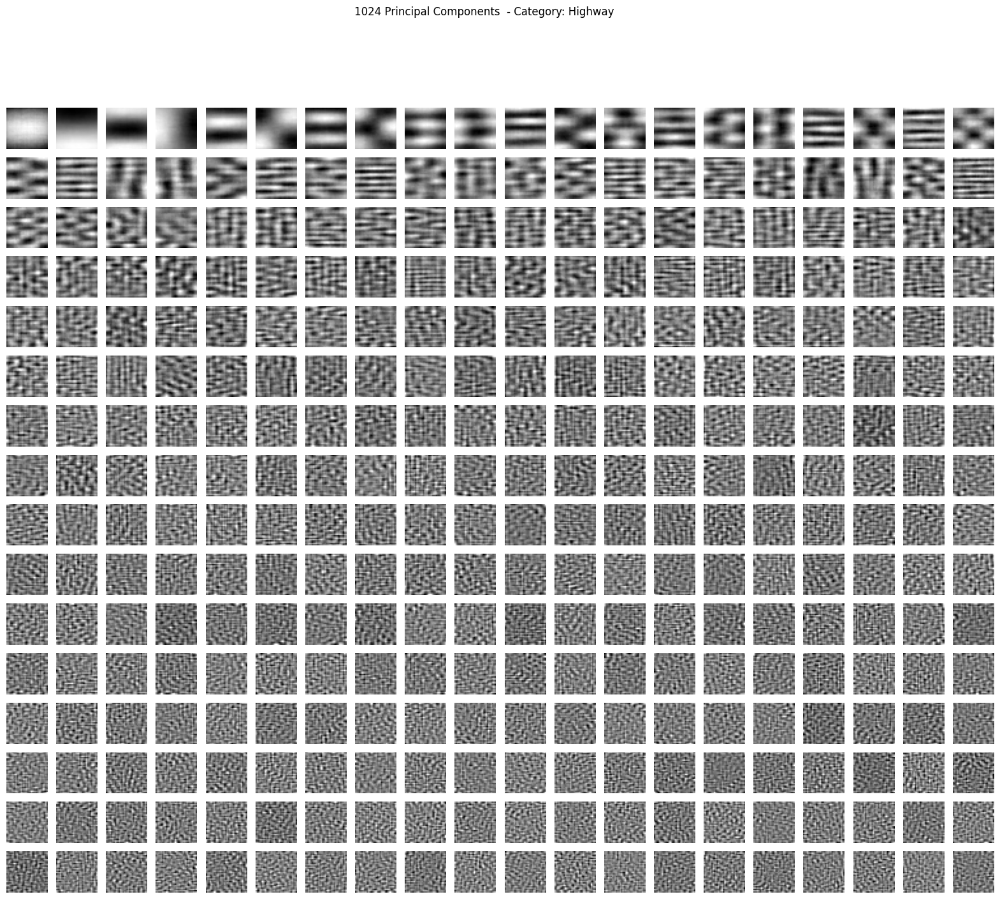

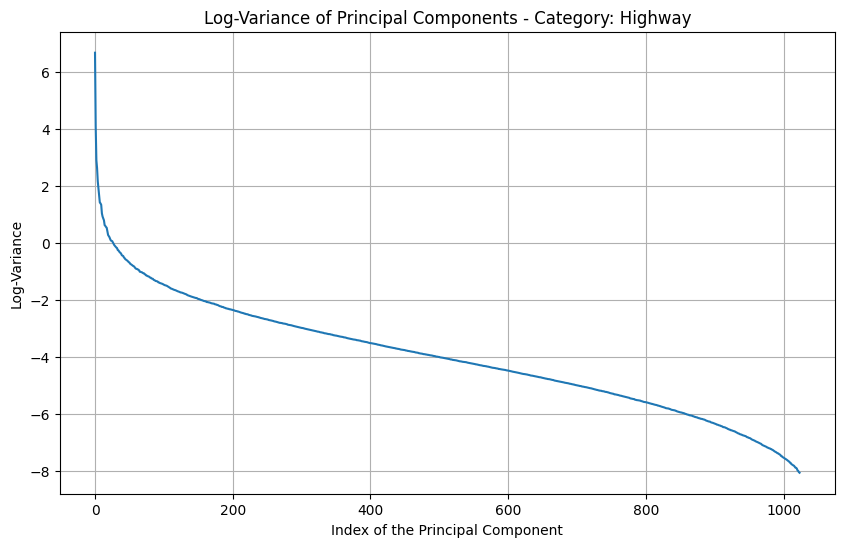

Category: Highway
Number of components that explain 95% of variance: 46
[[-0.10249374 -1.2121316  -1.4476854  ... -0.05317071  1.5830412
   1.4182577 ]
 [-0.1817785   1.3853847   1.2758852  ... -0.42904806 -0.4264754
  -0.32320276]
 [-1.6564753  -1.5289018  -1.7327102  ... -1.2788578  -1.4720775
  -1.4239372 ]
 ...
 [-0.05492288  0.14998059  0.10411645 ... -0.23293814 -0.1814124
  -0.04391194]
 [-0.38791892 -0.38852888 -0.38675964 ... -0.9029804  -0.6388633
  -0.45463374]
 [-0.97462624 -1.0220695  -1.0201482  ... -0.26562312 -0.21408747
  -0.01105419]]


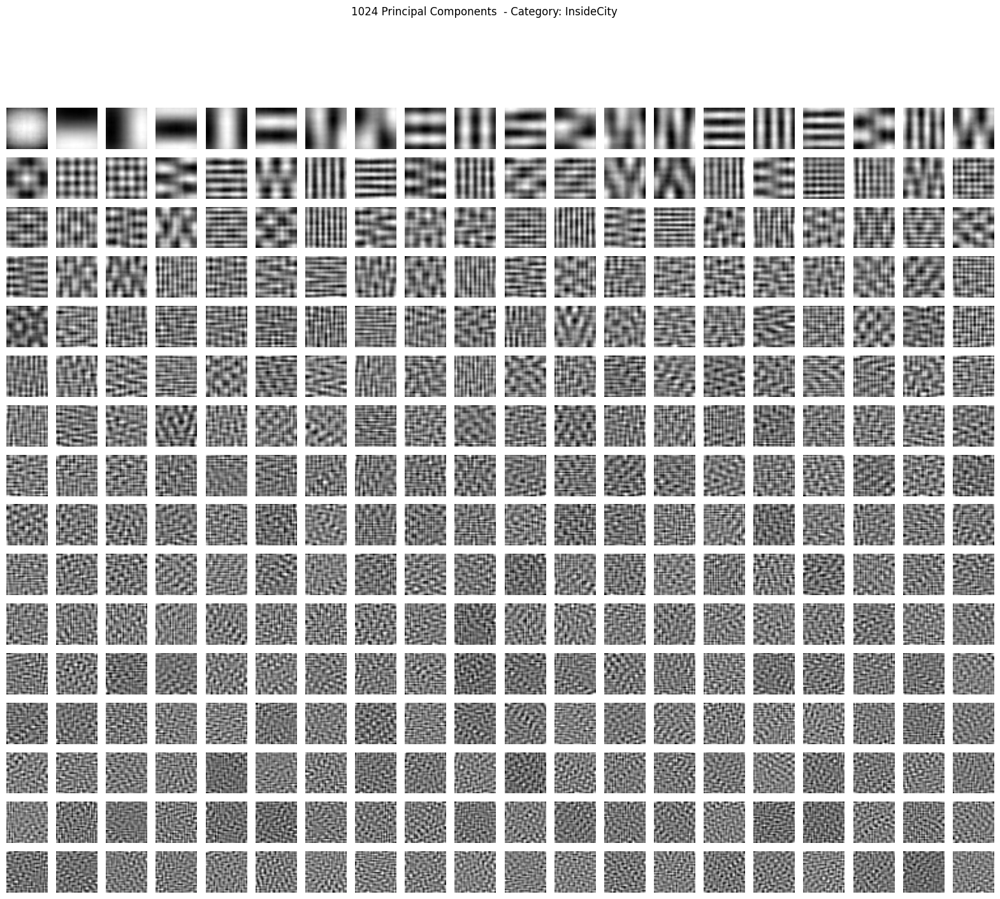

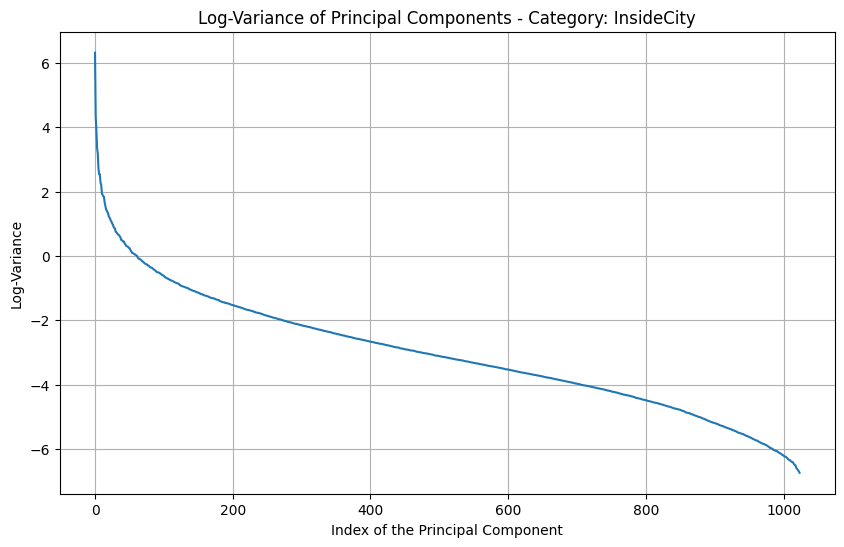

Category: InsideCity
Number of components that explain 95% of variance: 155
[[ 0.8910221   0.81366956  0.81162435 ... -1.3059397  -0.4216107
   1.6051376 ]
 [ 1.0124896   0.61531943  0.26289272 ...  0.31982815  0.2189584
   0.02808274]
 [ 1.5439097   1.8359357  -0.4535069  ... -0.24695332 -0.48119855
  -0.37361988]
 ...
 [ 0.8302884   1.1645968   1.1469604  ...  1.1998309   1.1723635
   0.42978537]
 [ 0.3899689  -0.05601949 -0.01147308 ... -0.1425462  -0.39181682
  -0.26947477]
 [-0.5514038  -0.5747814  -0.57544726 ...  0.09609862  0.11467969
   0.13222787]]


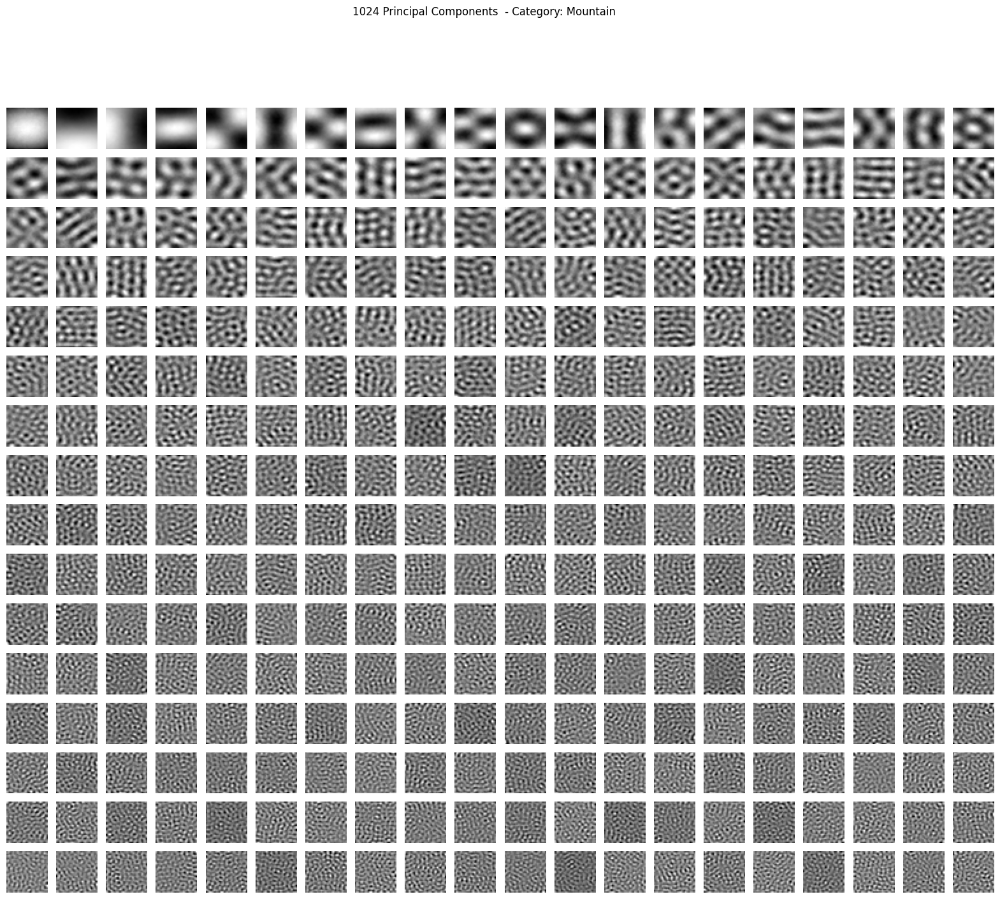

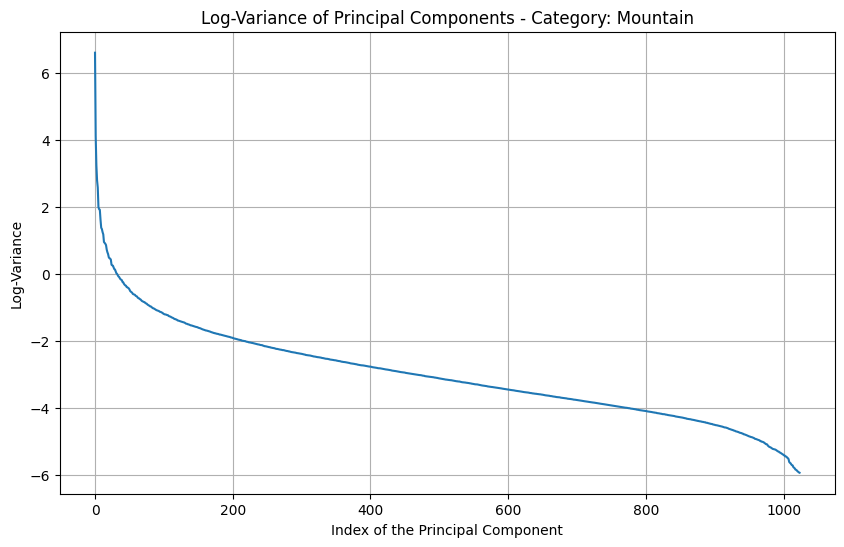

Category: Mountain
Number of components that explain 95% of variance: 117
[[ 0.00903085  0.42035997  1.3235972  ... -1.4704108  -1.0248448
  -0.7124999 ]
 [-0.35109204 -0.5620545  -0.1195095  ...  0.5228851   0.8188567
   0.42511663]
 [-0.9240148  -0.9058995  -0.3162968  ...  0.7370408   0.60485566
   0.45809102]
 ...
 [ 0.17272307  0.61684287  0.0444799  ...  0.19341467  0.27562326
   0.44160384]
 [-0.12192293 -0.3655716   0.17567141 ...  0.32520285  0.20977677
   0.37565506]
 [-0.13829215 -0.11996798 -0.10311056 ...  0.40757045  0.40731624
   0.40862945]]


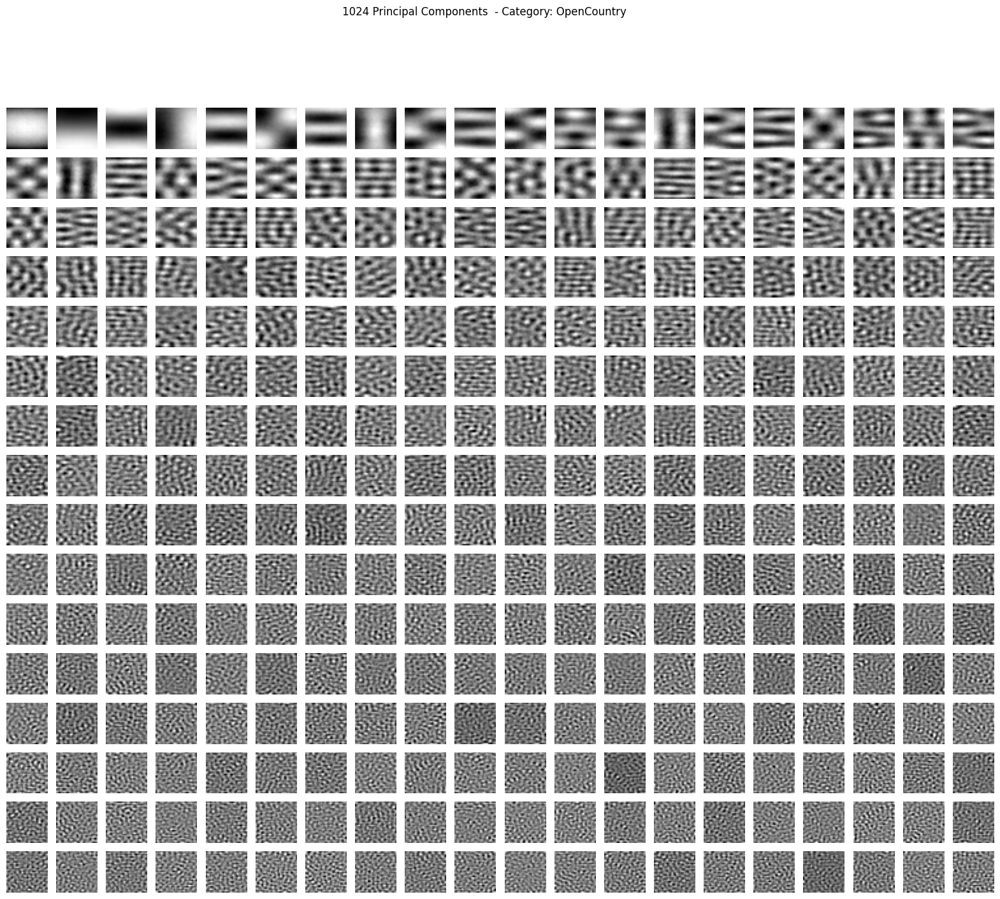

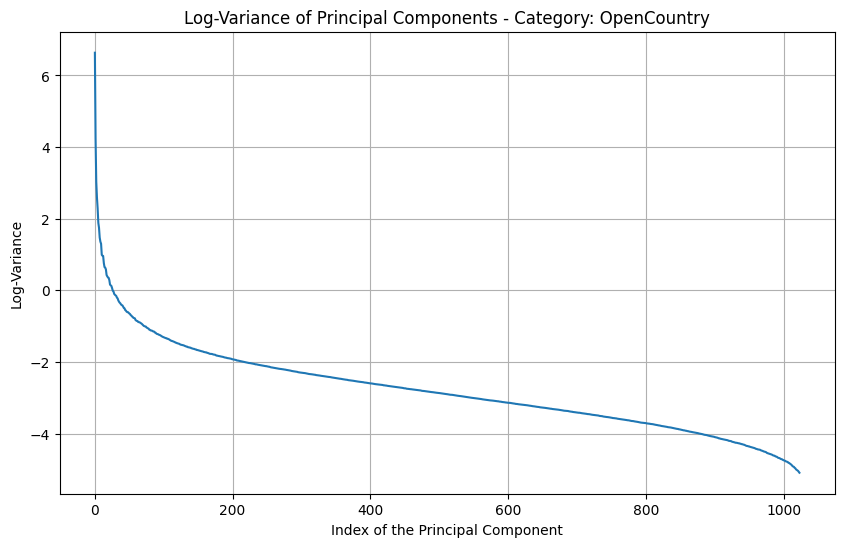

Category: OpenCountry
Number of components that explain 95% of variance: 148
[[-1.4066415e-01 -1.4681700e-01 -1.6093102e-01 ... -2.6217785e-01
  -2.6060185e-01 -2.5655583e-01]
 [ 4.5730691e-02  9.7254448e-02  2.8385237e-01 ... -7.3939902e-01
  -1.5268330e-01  2.5248876e-01]
 [-1.1621564e-02 -3.1959850e-02 -4.6148214e-02 ... -9.2841290e-02
  -7.5598635e-02 -1.3315108e-01]
 ...
 [ 4.3285841e-01  8.2897305e-02  4.2733088e-01 ... -6.1624515e-01
   3.4065858e-01 -1.6400227e-01]
 [-3.2705897e-01 -3.3345988e-01  1.1590713e+00 ...  1.4918330e-02
   1.4860347e-03 -7.3474926e-01]
 [-1.4884422e+00 -1.1374600e+00 -1.3518027e+00 ... -8.3176440e-01
  -8.7727922e-01 -8.1187725e-01]]


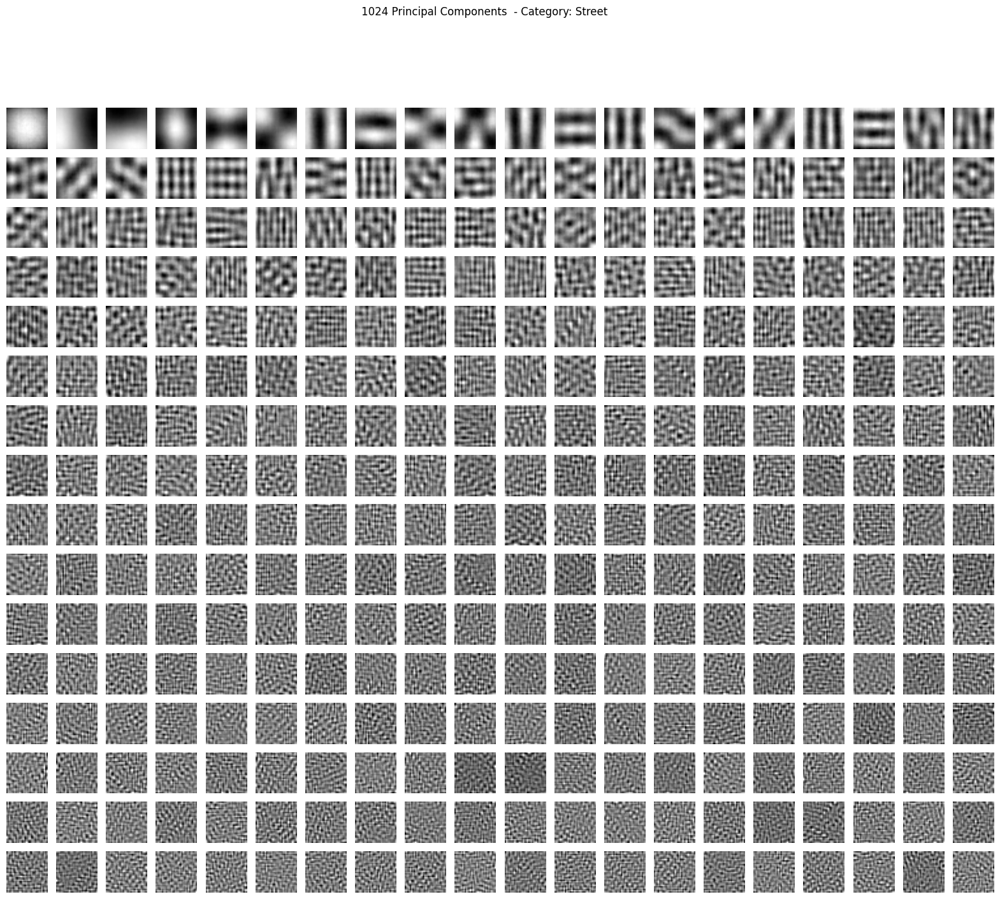

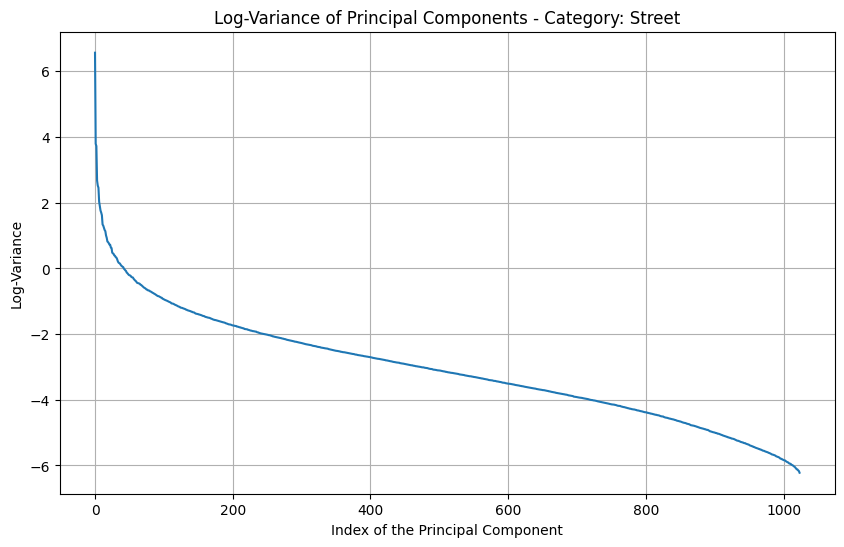

Category: Street
Number of components that explain 95% of variance: 135
[[-0.48241547 -0.13787718 -1.0597322  ... -0.6412788  -0.67099047
  -0.79229206]
 [-0.7670274  -0.80288434 -0.9167084  ... -0.23135576 -0.13582523
  -0.33616877]
 [-1.0358275  -1.1353879  -1.0597322  ... -0.97237045 -0.93857306
  -0.870934  ]
 ...
 [ 0.75090265  0.748799    0.7519024  ...  0.8565169   0.85580444
   0.85918885]
 [-0.9093333  -0.8978854  -0.58298624 ...  0.68308794  0.6826628
   0.68617654]
 [ 0.38723192  0.2896274   0.16391572 ...  0.63578916  0.33637938
  -0.9653044 ]]


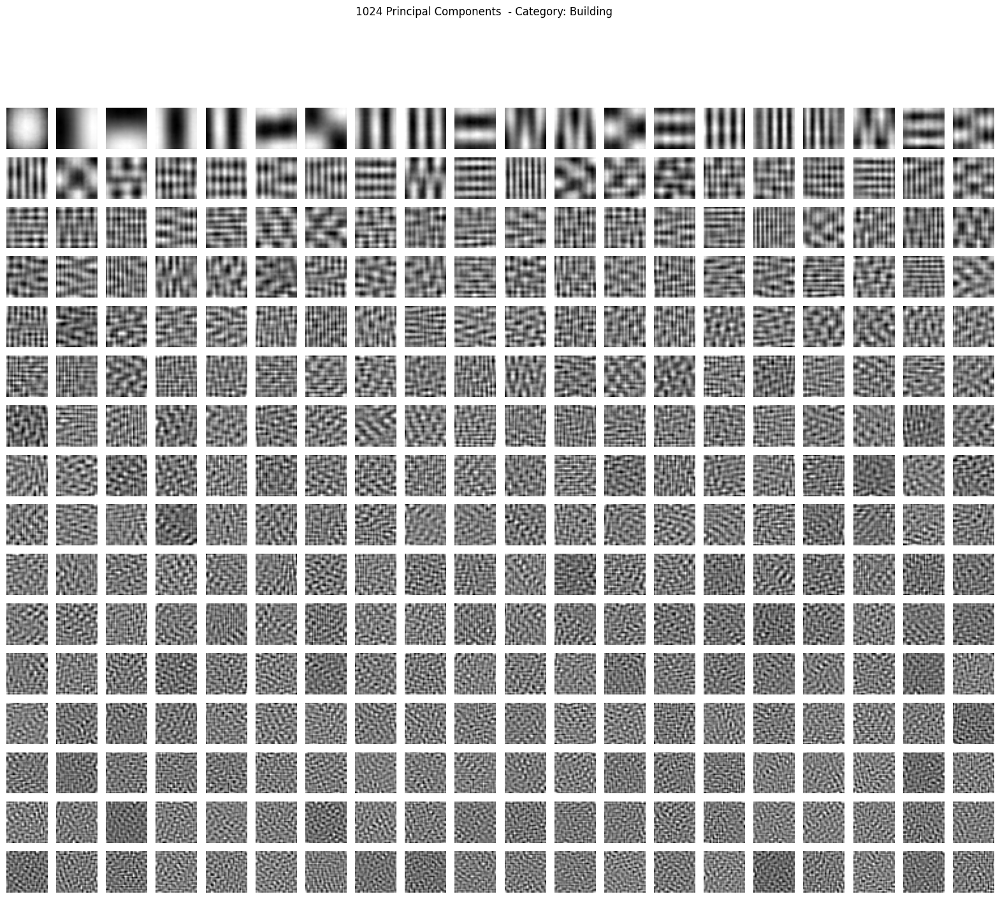

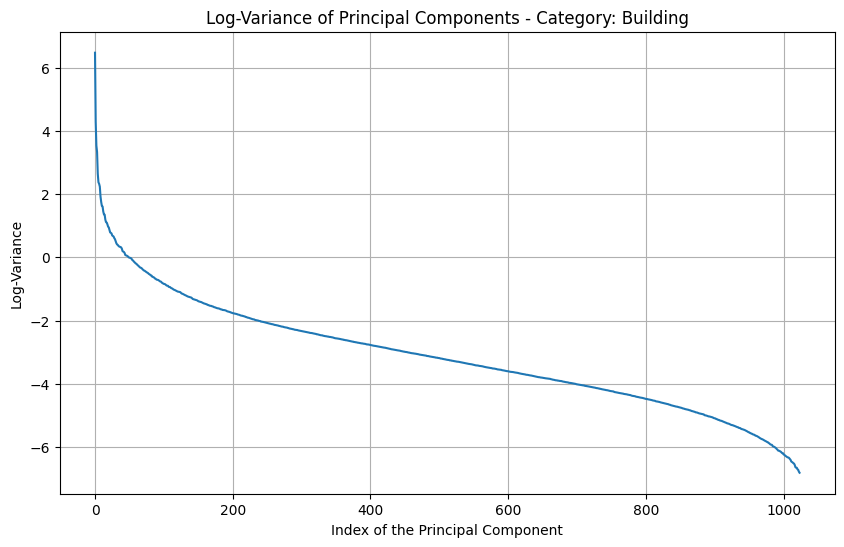

Category: Building
Number of components that explain 95% of variance: 127
[[-1.4833683  -1.4516696  -1.4184849  ... -0.7915871  -0.61947614
  -0.6794003 ]
 [-1.0676453  -1.0206215  -1.0342126  ... -0.80593324 -0.7343158
  -0.73693603]
 [-0.5133479  -0.5126006  -0.5116024  ... -0.74854875 -0.7343158
  -0.73693603]
 ...
 [-0.32858214 -0.29707655 -0.26566818 ...  0.37044868  0.3710158
   0.37062567]
 [ 1.54987     1.5040885   1.4405005  ...  2.063291    2.0792553
   2.0823119 ]
 [ 0.16412662  0.16476065  0.16471674 ...  0.27002585  0.2705311
   0.26993826]]


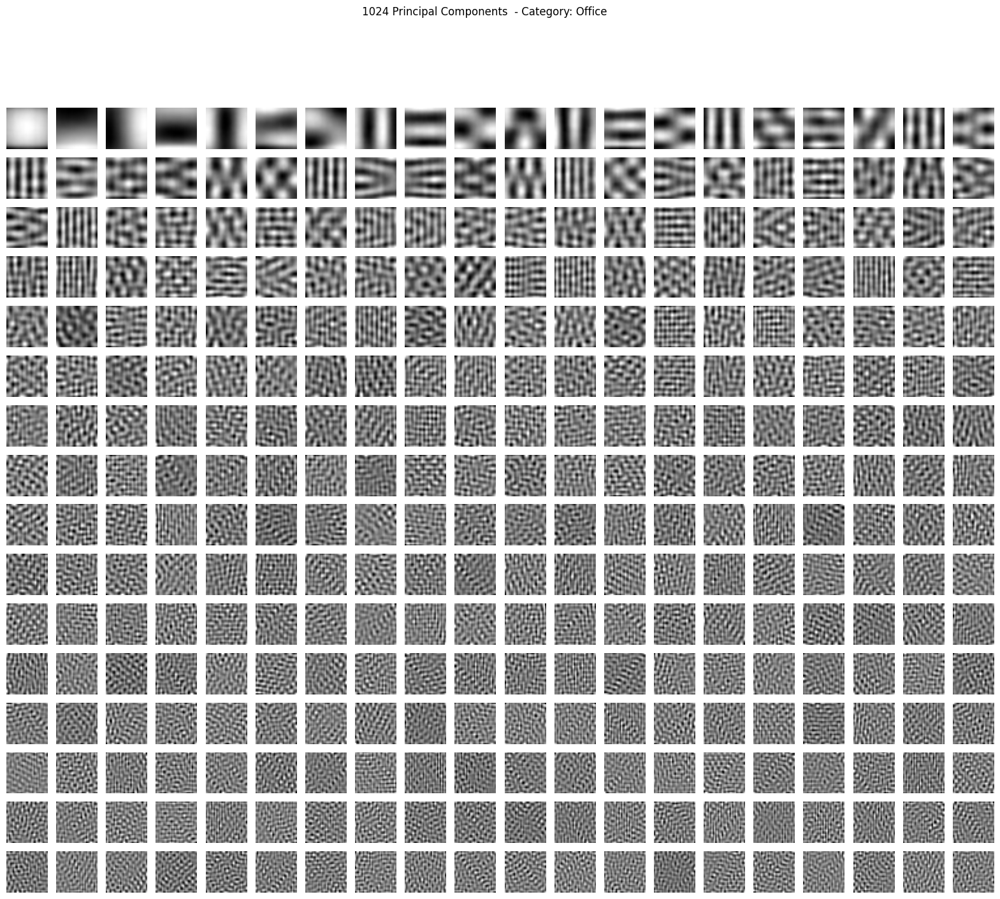

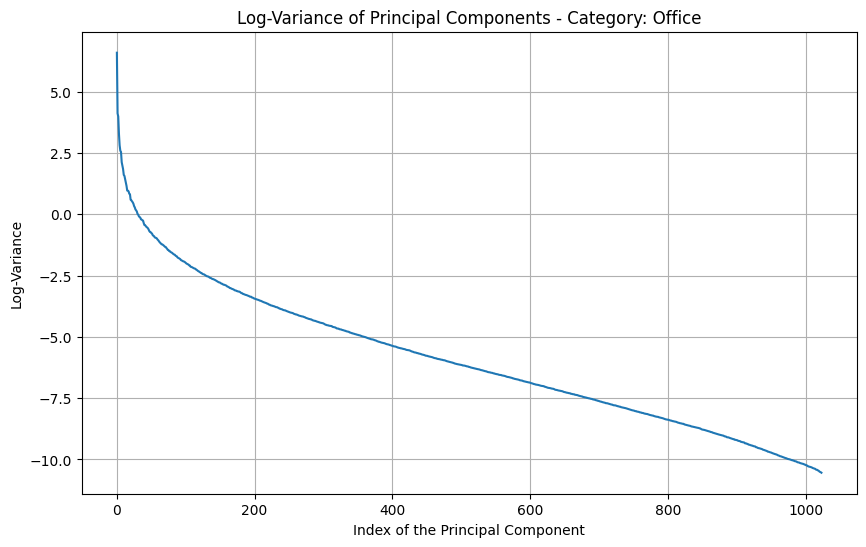

Category: Office
Number of components that explain 95% of variance: 21
[[ 0.97436917  0.9974975   1.0232699  ...  1.9827808   2.0618958
   2.1810267 ]
 [ 1.6362497   1.6452436   1.6850511  ...  1.0529023   1.2275691
   1.4612241 ]
 [-1.0585494  -1.3565066  -1.0723708  ...  0.7162223   0.7301821
   0.7094301 ]
 ...
 [ 0.28097057  0.2865567   0.2984618  ...  0.31541264  0.42533198
   0.43750462]
 [-0.12876494 -0.14000782 -0.126969   ...  0.31541264  0.34510824
   0.19757037]
 [ 0.28097057  0.2865567   0.2827051  ...  0.29938027  0.29697403
   0.29354405]]


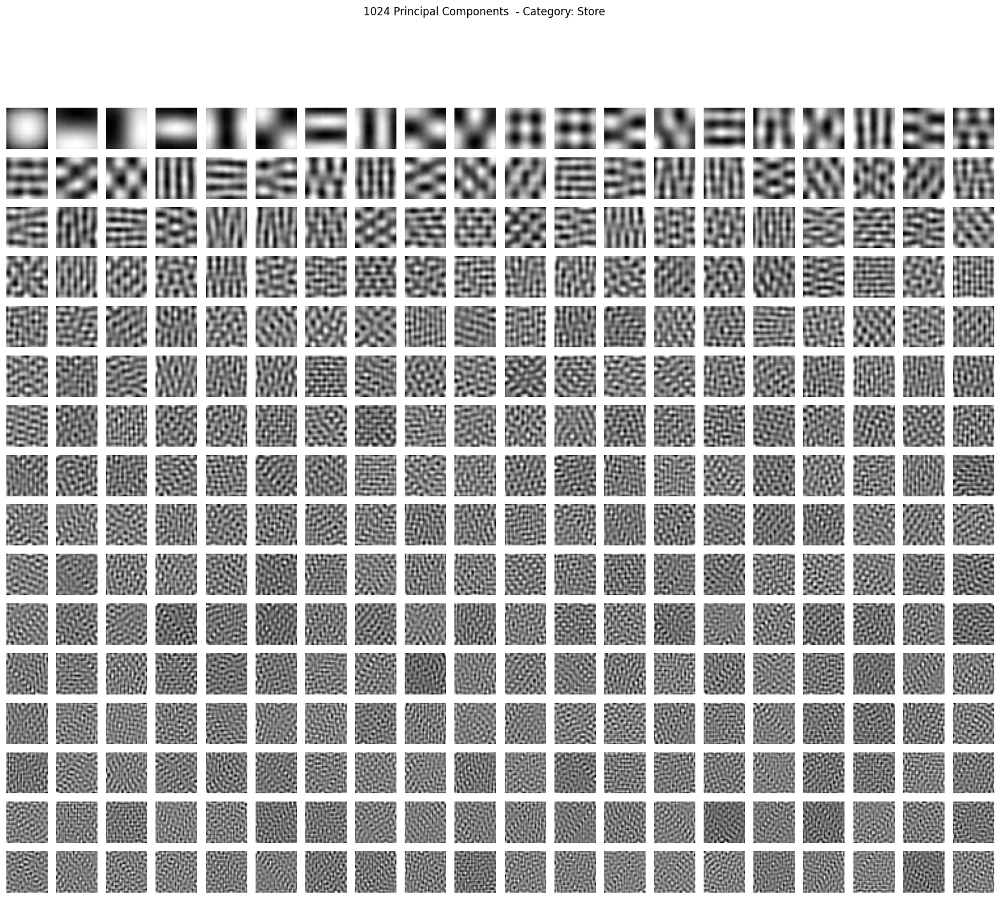

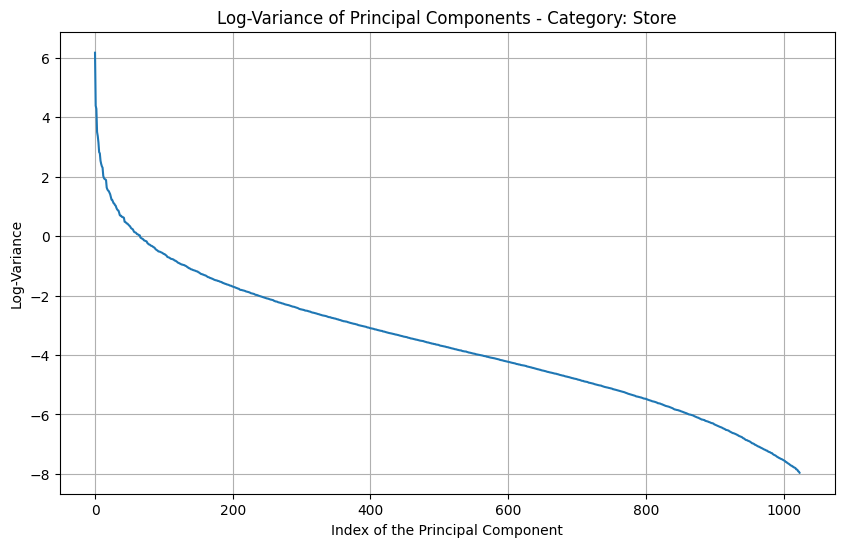

Category: Store
Number of components that explain 95% of variance: 115
{'Bedroom': PCA(n_components=26), 'Suburb': PCA(n_components=30), 'Industry': PCA(n_components=49), 'Kitchen': PCA(n_components=40), 'LivingRoom': PCA(n_components=31), 'Coast': PCA(n_components=23), 'Forest': PCA(n_components=458), 'Highway': PCA(n_components=46), 'InsideCity': PCA(n_components=155), 'Mountain': PCA(n_components=117), 'OpenCountry': PCA(n_components=148), 'Street': PCA(n_components=135), 'Building': PCA(n_components=127), 'Office': PCA(n_components=21), 'Store': PCA(n_components=115)}


In [12]:
pca_by_category, nummin_components_95_dict, min_components = apply_pca_and_visualize(normalized_patches_by_category)
print(pca_by_category)

In [13]:
def compute_residuals_with_pca(patches_by_category, pca_by_category):
    residuals = {}
    for category, patches in patches_by_category.items():
        if patches.size == 0:
            continue  # Pular se não houver patches para esta categoria

        # Normalizar patches
        #patches = normalize_patches(patches)

        # Obter PCA da categoria
        pca = pca_by_category[category] #usar o pc com minimo de dimensoes

        # Projetar dados nos componentes principais
        projected_data = pca.transform(patches)
        # Reconstruir dados a partir da projeção
        reconstructed_data = pca.inverse_transform(projected_data)
        # Calcular os resíduos
        residuals[category] = patches - reconstructed_data
    return residuals


residuals_by_category = compute_residuals_with_pca(normalized_patches_by_category, pca_by_category)


In [14]:
# Função para calcular a métrica OOD para uma imagem individual
def calculate_ood_for_image(image, pca, residuals_by_category):
    #print(f'image: {image}')
    image = image.reshape(1, -1) 
    projected_data = pca.transform(image)
    reconstructed_data = pca.inverse_transform(projected_data)
    residual = image - reconstructed_data

    
    norm_residual = np.linalg.norm(residual)
    #print("NORM RESIDUAL: " + str(norm_residual))
    norm_image = np.linalg.norm(image)
    #print("NORM IMAGE: " + str(norm_image))
    
    ood_metric = norm_residual / (norm_image)
    return ood_metric

# Calcular a métrica OOD para cada patch do Bedroom
def calculate_ood_for_patches(patches, pca, residuals_by_category):
    ood_metrics = []
    for patch in patches:
        #print(patch)
        ood_metric = calculate_ood_for_image(patch, pca, residuals_by_category)
        ood_metrics.append(ood_metric)
    return np.array(ood_metrics)

In [15]:
test_patches_by_category = load_patches_by_category('patches_test', y, patch_size)

OOD[Bedroom] = 0.23130139708518982


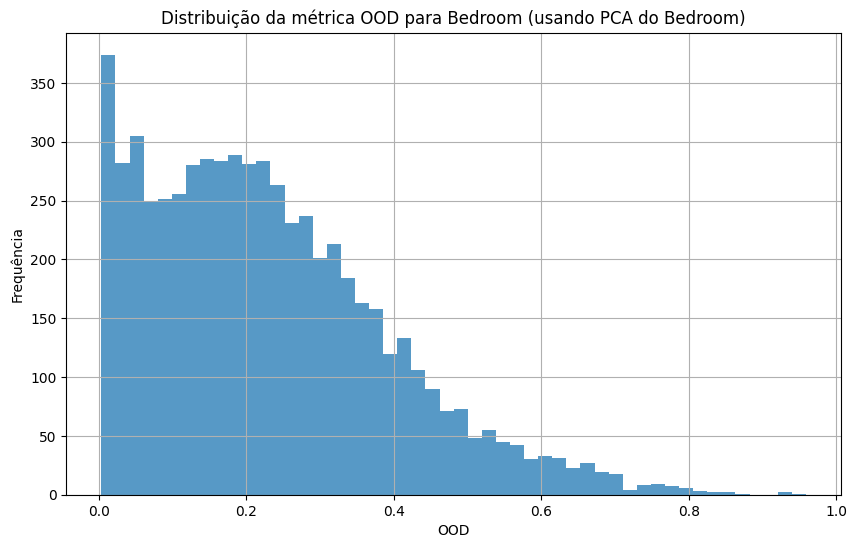

OOD[Suburb] = 0.22605961561203003


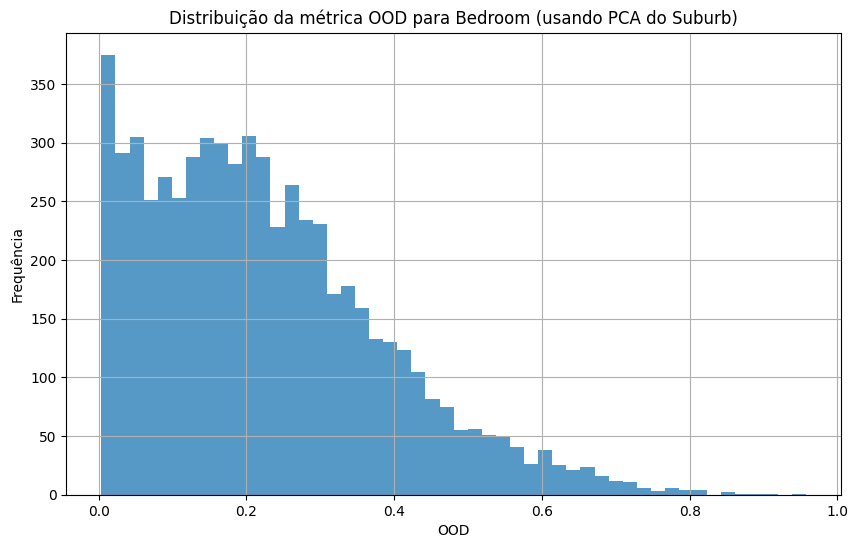

OOD[Industry] = 0.18464526534080505


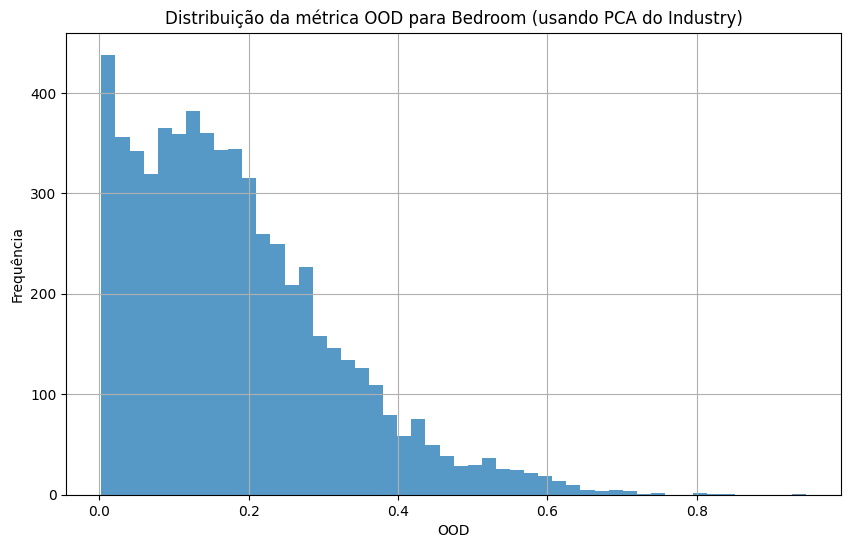

OOD[Kitchen] = 0.20026414096355438


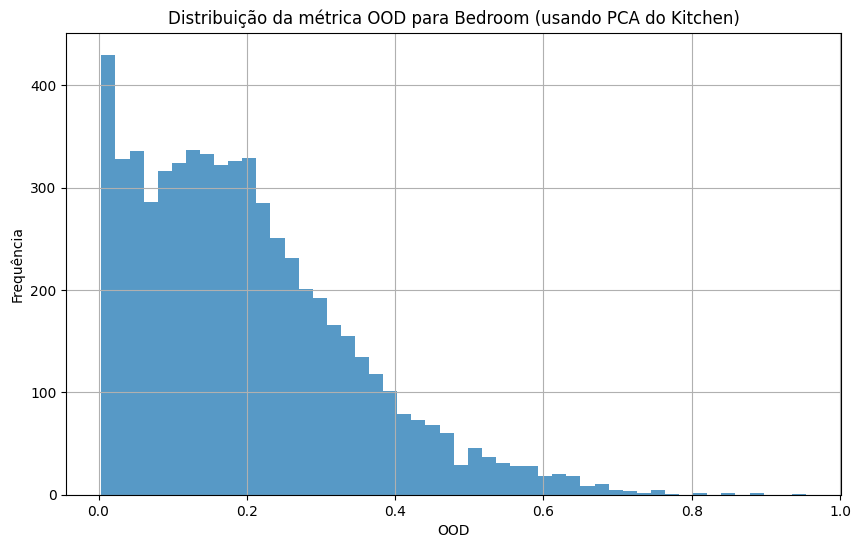

OOD[LivingRoom] = 0.21915341913700104


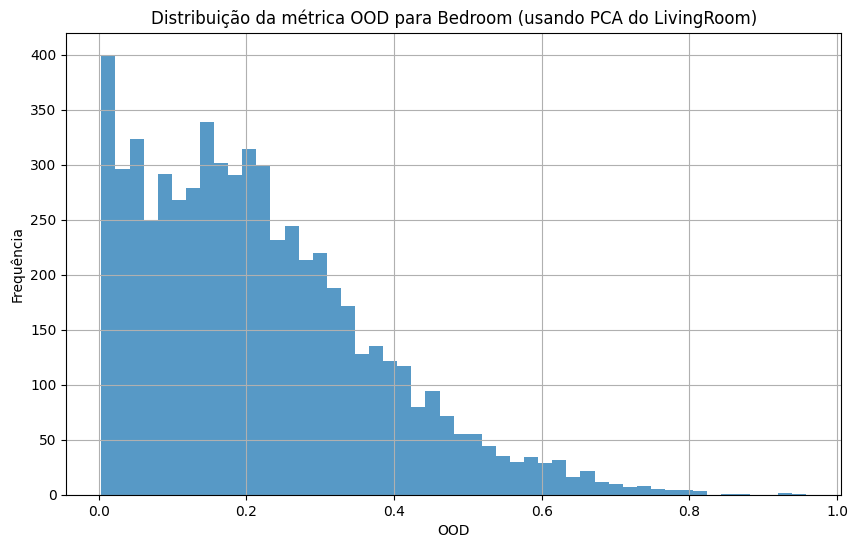

OOD[Coast] = 0.2726641893386841


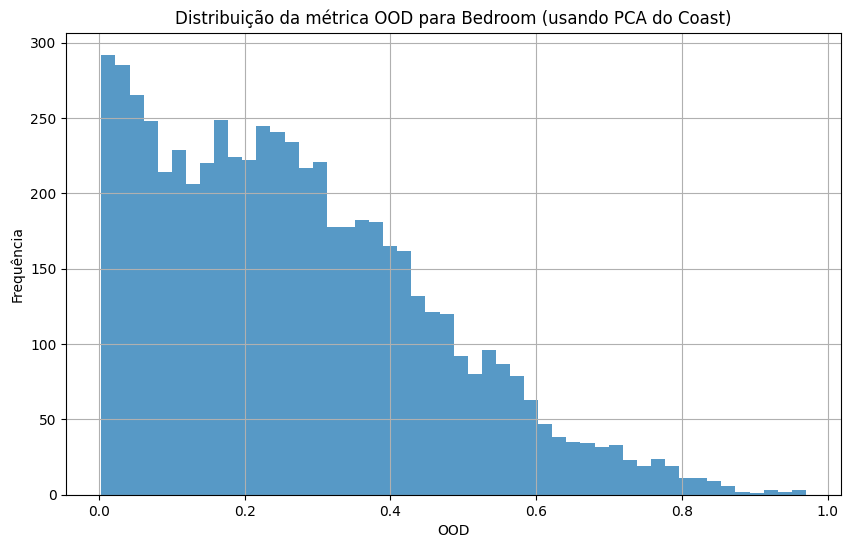

OOD[Forest] = 0.05190200358629227


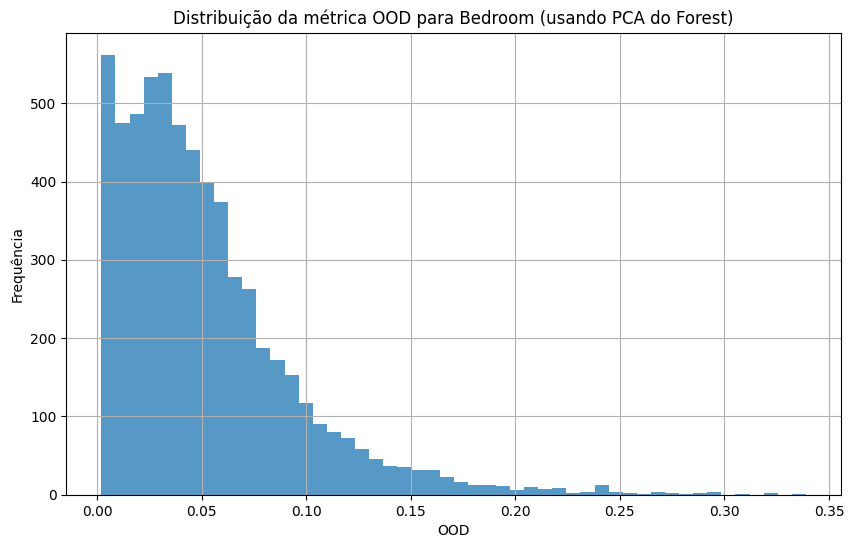

OOD[Highway] = 0.21007445454597473


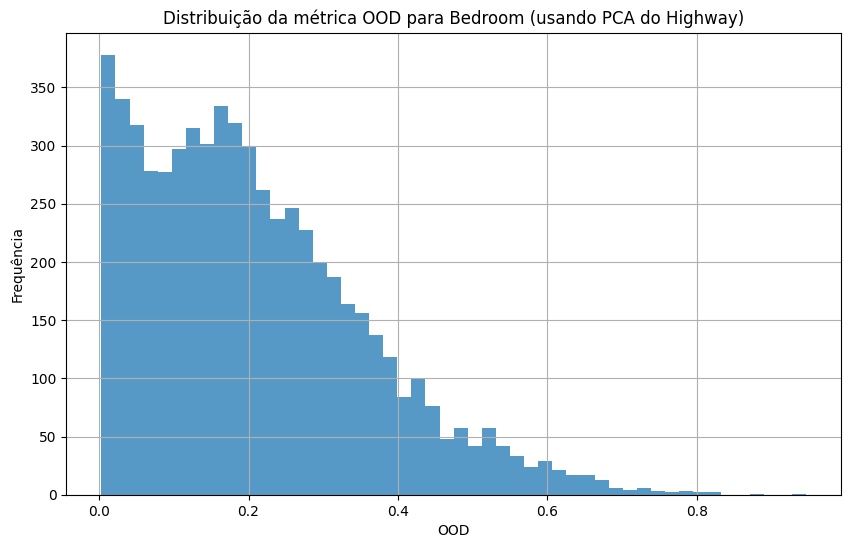

OOD[InsideCity] = 0.11101630330085754


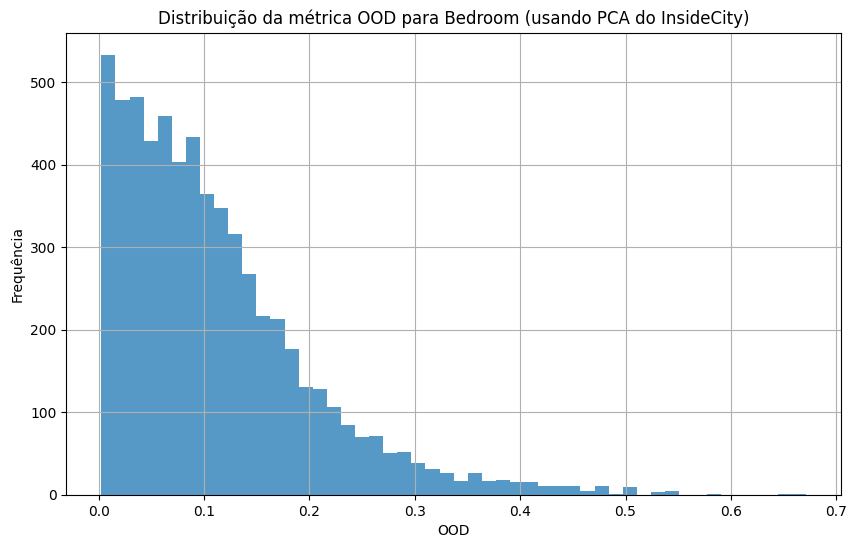

OOD[Mountain] = 0.13972271978855133


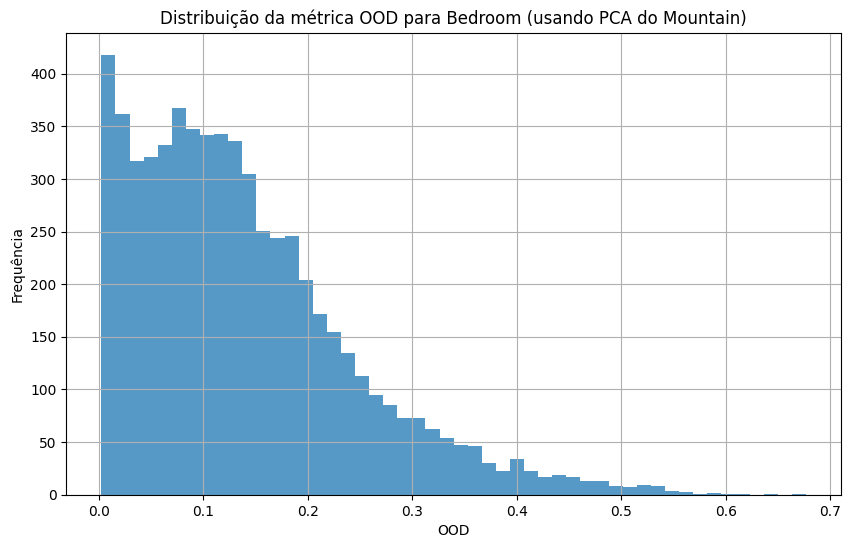

OOD[OpenCountry] = 0.127256840467453


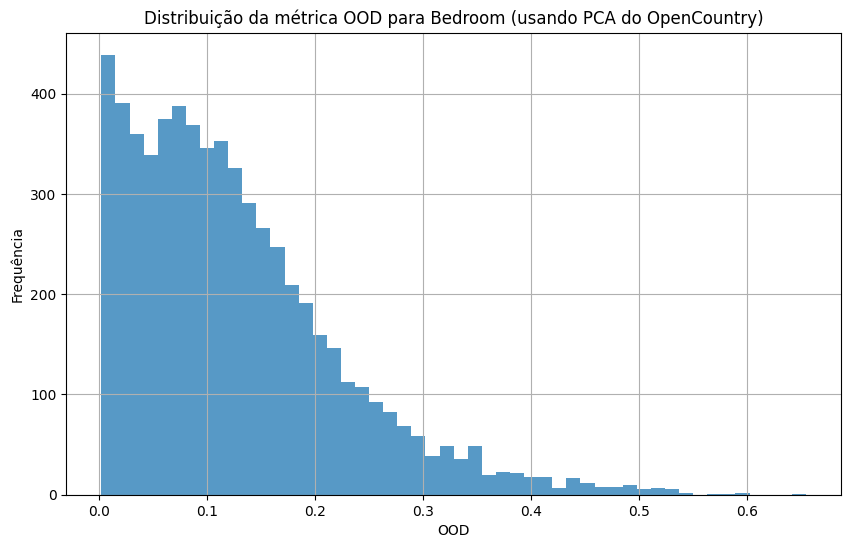

OOD[Street] = 0.11593407392501831


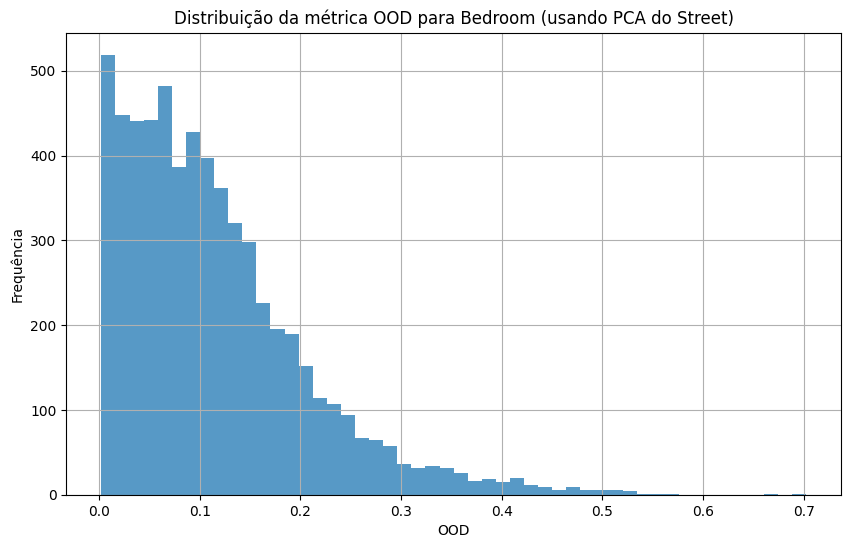

OOD[Building] = 0.1214548721909523


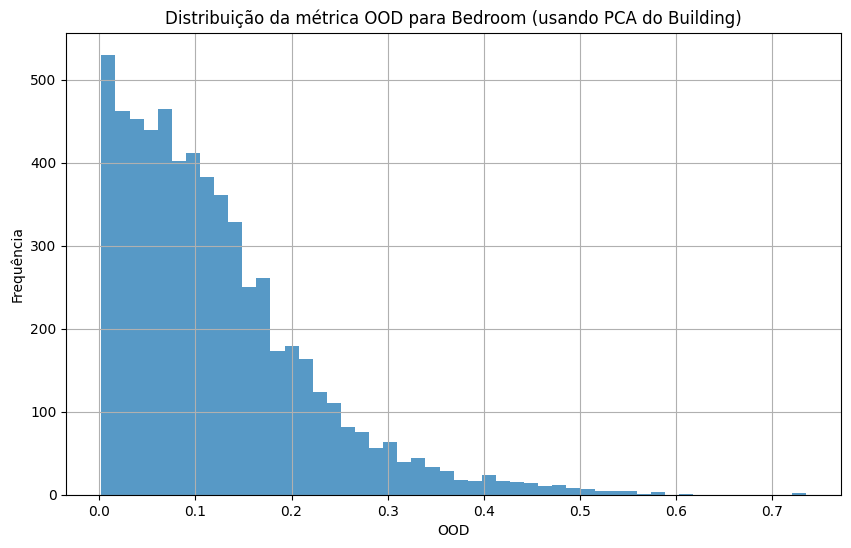

OOD[Office] = 0.25087279081344604


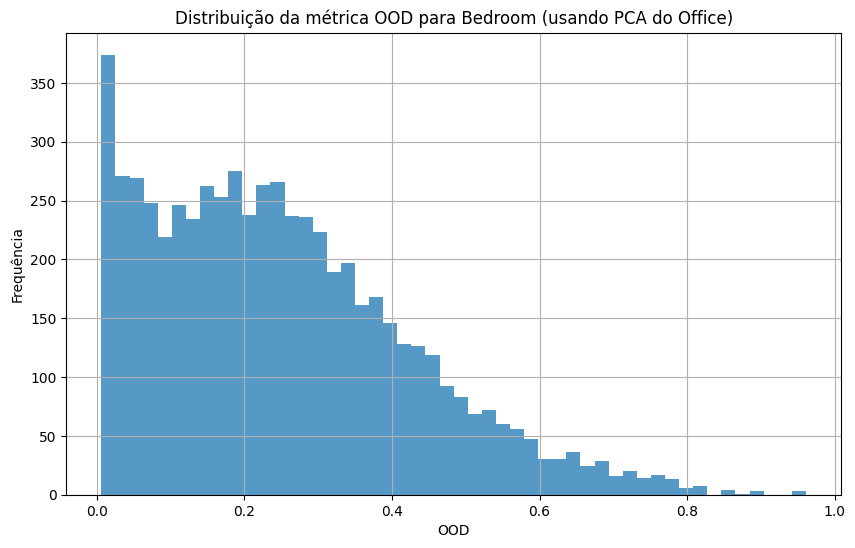

OOD[Store] = 0.12413088977336884


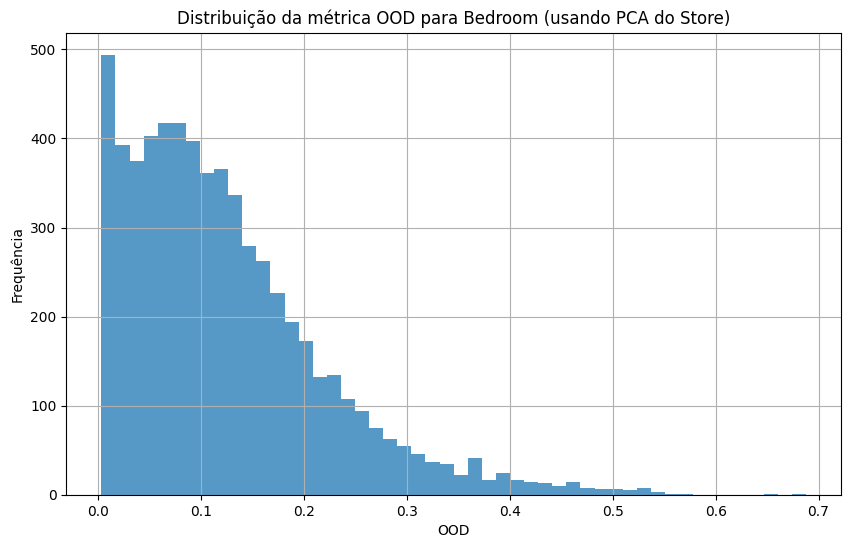

In [16]:
target_patches_environment = test_patches_by_category['Bedroom']
target_environment = 'Bedroom'
target_normalized_patches= normalize_patches(target_patches_environment)
#target_environment_pca = pca_by_category[test_environment]

ood_metrics = {}
ood_mean = {}

for category in test_patches_by_category:
	test_patches_environment = test_patches_by_category[category]
	test_normalized_patches= normalized_patches_by_category[category]
	test_pca = pca_by_category[category]
	test_environment_residuals = residuals_by_category[category]

	# Calcular a métrica OOD para cada patch do Bedroom usando PCA do Bedroom
	ood_metrics[category]= calculate_ood_for_patches(target_normalized_patches, test_pca, test_environment_residuals)
	mean_ood = np.mean(ood_metrics[category])

	print(f"OOD[{category}] = {mean_ood}")
	ood_mean[category] = mean_ood


	# Visualizar a distribuição dos valores de OOD para Bedroom usando PCA do Bedroom
	plt.figure(figsize=(10, 6))
	plt.hist(ood_metrics[category], bins=50, alpha=0.75)
	plt.title(f"Distribuição da métrica OOD para {target_environment} (usando PCA do {category})")
	plt.xlabel("OOD")
	plt.ylabel("Frequência")
	plt.grid(True)
	plt.show()



In [17]:
print(ood_mean)

min_ood_category = min(ood_metrics, key=lambda k: np.mean(ood_metrics[k]))
min_ood_value = np.mean(ood_metrics[min_ood_category])

print(f"Estamos no ambiente {min_ood_category} com OOD: {min_ood_value}")


{'Bedroom': 0.2313014, 'Suburb': 0.22605962, 'Industry': 0.18464527, 'Kitchen': 0.20026414, 'LivingRoom': 0.21915342, 'Coast': 0.2726642, 'Forest': 0.051902004, 'Highway': 0.21007445, 'InsideCity': 0.1110163, 'Mountain': 0.13972272, 'OpenCountry': 0.12725684, 'Street': 0.115934074, 'Building': 0.12145487, 'Office': 0.2508728, 'Store': 0.12413089}
Estamos no ambiente Forest com OOD: 0.05190200358629227


: 